# **Unified classification and risk-stratification in Acute Myeloid Leukemia**


>>> # **Tutorial for Patient centric model** : 

In [1]:
R.version.string

[1] "R version 4.1.0 (2021-05-18)"

In [3]:

options(warn=-1)

# Step 1: Install and load missing libraries
# start_time <- Sys.time()
some_packages <- c("mstate","survminer","colorspace","gridExtra","stringr")
for (package in some_packages){
#   if(!require(package,character.only = TRUE)){
#     install.packages(package,character.only = TRUE)
#   }
  library(package,character.only=TRUE)
}
# end_time <- Sys.time()
# paste0("It takes :", round(end_time-start_time,2), " minutes to install all the libraries (survminer takes a LOT of time!)")

In [4]:
source('src/tools_analysis_bis.R')
statecols <- heat_hcl(6, c = c(80, 30), l = c(30, 90),power = c(1/5, 2))[c(6,5,4,3,2,1)]
ord <- c(1,2,3,4,5,6)

# CI for sediment plot and barplot :
conf.int <- 0.95
crit <- qnorm((1 - conf.int) / 2, lower.tail = FALSE)

# **Helper Functions:**

## **1. Classify patients in components annd proposal**

## **2. Find principal class**

## **3. ELN classifier**

In [5]:
classify_components <- function(user_data,keep=c(demo,clin,comp,"ITD"),proposal=T){
    factors <- c("ZRSR2","U2AF1_p.S34","U2AF1_p.Q157","SRSF2","SF3B1","ASXL1","STAG2","BCOR","RUNX1","EZH2","MLL","PHF6","SF1","NF1","CUX1","SETBP1")
    
    layer1 <- c("full_component_t_15_17","full_component_inv_16","full_component_t_8_21",
           "full_component_t_11","full_component_t_6_9","full_component_inv_3",
           "full_component_NPM1","full_component_CEBPA_bi","full_component_TP53_complex",
           "full_component_sAML2")
    
    user_data["full_component_t_15_17","value"] <- ifelse(user_data["t_15_17","value"]==1,1,0)
    
    user_data["full_component_inv_16","value"] <- ifelse(user_data["inv_16","value"]==1,1,0)
    
    user_data["full_component_t_8_21","value"] <- ifelse(user_data["t_8_21","value"]==1,1,0) 
    
    user_data["full_component_t_11","value"] <- ifelse((user_data["t_v_11","value"]==1 | user_data["t_9_11","value"]==1),1,0)   
    
    user_data["full_component_t_6_9","value"] <- ifelse(user_data["t_6_9","value"]==1,1,0) 
    
    user_data["full_component_inv_3","value"] <- ifelse(user_data["inv_3","value"]==1,1,0)
    
    user_data["full_component_NPM1","value"] <- ifelse(user_data["NPM1","value"]==1,1,0) 
    
    user_data["full_component_CEBPA_bi","value"] <- ifelse(user_data["CEBPA_bi","value"]==1,1,0)
    
#     user_data["full_component_Trisomies","value"] <- ifelse((user_data["add_8","value"]==1 | user_data["add_11","value"]==1 |
#                                                              user_data["add_13","value"]==1 | user_data["add_21","value"]==1 |
#                                                              user_data["add_22","value"]==1),1,0)
    
    user_data["full_component_TP53_complex","value"] <- ifelse((user_data["TP53","value"]==1 | user_data["complex","value"]==1) ,1,0)
    
 # Remove from TP53-complex the ones that are complex, no TP53 and no deletions.
# get names of TP53 complex without TP53 and no deletions so that we move them later to Trisomies
    
    num_deletions <- sum(user_data[c(grep("minus",rownames(user_data)),grep("del_",rownames(user_data))),"value"])
    no_deletions_for_complex_no_TP53 <- ifelse((user_data["TP53","value"]==0 & user_data["complex","value"]==1 & num_deletions==0),T,F)                   
                         
    user_data["full_component_TP53_complex","value"] <- ifelse((user_data["TP53","value"]==0 & user_data["complex","value"]==1  &  num_deletions==0) ,0,user_data["full_component_TP53_complex","value"]) 
                         
# Layer 2
                         
    user_data["full_component_sAML2","value"] <- ifelse(sum(user_data[factors,"value"],na.rm=T)>1 ,1,0)  
                         
    user_data["full_component_sAML1","value"] <- ifelse(sum(user_data[factors,"value"],na.rm=T)==1 & sum(user_data[layer1,"value"])==0 ,1,0)

    user_data["full_component_sAML2","value"] <- ifelse(user_data["full_component_sAML1","value"]==1 &
                                                                 (user_data["DNMT3A","value"]==1 | user_data["TET2","value"]==1 ),1,
                                                                        user_data["full_component_sAML2","value"])
    
    user_data["full_component_sAML1","value"] <- ifelse(user_data["full_component_sAML1","value"]==1 &
                                                                 (user_data["DNMT3A","value"]==1 | user_data["TET2","value"]==1 ),0,
                                                                        user_data["full_component_sAML1","value"])
     
    user_data["full_component_WT1","value"] <- ifelse( sum(user_data[c(layer1,"full_component_sAML1"),"value"])==0 & user_data["WT1","value"]==1,1,0)                                          
                                             
##### Special rules Trisomies######
    # 1) one of main Trisomies (+8,+11,+13,+21,+22) and did not belong to other components
    user_data["full_component_Trisomies","value"] <- ifelse(sum(user_data[c(layer1,"full_component_sAML1","full_component_WT1"),"value"])==0  & (user_data["add_8","value"]==1 | user_data["add_11","value"]==1 |
                                                             user_data["add_13","value"]==1 | user_data["add_21","value"]==1 |
                                                             user_data["add_22","value"]==1),1,0)

    # 2) Add in Trisomies the ones that are complex, no TP53 and no deletions i.e 
    
    user_data["full_component_Trisomies","value"] <- ifelse(no_deletions_for_complex_no_TP53,1,user_data["full_component_Trisomies","value"])

# 3) Finally, remove previous overlaps
                                             
    user_data["full_component_Trisomies","value"] <- ifelse(sum(user_data[c(layer1,"full_component_sAML1","full_component_WT1"),"value"])>0,0,user_data["full_component_Trisomies","value"])



    user_data["full_component_DNMT3A_IDH1_2","value"] <- ifelse((user_data["DNMT3A","value"]==1 & (user_data["IDH1","value"]==1 | user_data["IDH2_p.R140","value"]==1 | user_data["IDH2_p.R172","value"]==1)) &
                                                                sum(user_data[c(layer1,"full_component_sAML1","full_component_WT1","full_component_Trisomies"),"value"])==0,1,0)
    
    
    
# Layer 3
    
    
    
    
    user_data["full_component_mNOS","value"] <- ifelse((sum(user_data[c(all_gen,all_cyto),"value"],na.rm=T)>0 & sum(user_data[comp,"value"],na.rm=T)==0),1,0)
    
    user_data["full_component_no_events","value"] <- ifelse(sum(user_data[c(all_gen,all_cyto),"value"],na.rm=T)==0 ,1,0)
    

    
    user_data["overlap","value"] <- ifelse(sum(user_data[comp,"value"],na.rm=T) >1 ,1,0)
    
    
    
    
    # Get princ comp for the risk proposal
    
    comp_order <- c("full_component_NPM1","full_component_inv_16","full_component_t_8_21","full_component_t_15_17","full_component_TP53_complex","full_component_inv_3","full_component_t_11","full_component_t_6_9",
                      "full_component_sAML1","full_component_sAML2","full_component_CEBPA_bi",
                    "full_component_WT1",
                    "full_component_Trisomies",
                    "full_component_DNMT3A_IDH1_2",
              "full_component_mNOS","full_component_no_events")

    princ_comp <- comp_order[which(user_data[comp_order,"value"]==1)][1]


        

    
    if (proposal==T){
        
        user_data[c("NEW_favorable","NEW_intermediate","NEW_adverse"),"value"] <- 0
        
        
        
        user_data["NEW_favorable","value"] <- ifelse(princ_comp %in% c("full_component_NPM1" , "full_component_inv_16" ,  "full_component_t_8_21" ,  "full_component_t_15_17",
         "full_component_CEBPA_bi",  "full_component_no_events"),1,0)
        
        user_data["NEW_intermediate","value"] <- ifelse(princ_comp %in% c( "full_component_sAML1" , "full_component_t_6_9" , "full_component_DNMT3A_IDH1_2" , 
          "full_component_Trisomies" ,  "full_component_t_11" ,  "full_component_WT1" , "full_component_mNOS"),1,0)
        
        user_data["NEW_adverse","value"] <- ifelse(princ_comp %in% c( "full_component_sAML2" , "full_component_TP53_complex" , "full_component_inv_3"==1),1,0)
        
     
        

        #order is important! adverse then intermediate otherwise we  overlap
        
        user_data["NEW_adverse","value"] <- ifelse(user_data["NEW_intermediate","value"]==1 & user_data["ITD","value"]==1 ,1,user_data["NEW_adverse","value"] )
        user_data["NEW_intermediate","value"] <- ifelse(user_data["NEW_intermediate","value"]==1 & user_data["ITD","value"]==1 ,0,user_data["NEW_intermediate","value"])
        
        user_data["NEW_intermediate","value"] <- ifelse(user_data["NEW_favorable","value"]==1 & user_data["NPM1","value"]==1 & user_data["ITD","value"]==1 ,
                                                        1,user_data["NEW_intermediate","value"] )   # changing with NPM1 
        
        user_data["NEW_favorable","value"] <- ifelse(user_data["NEW_favorable","value"]==1 & user_data["NPM1","value"]==1 & user_data["ITD","value"]==1 ,
                                                     0,user_data["NEW_favorable","value"])  # changing with NPM1 

        return(user_data[c(keep,"NEW_favorable","NEW_intermediate","NEW_adverse"),,drop=F])
        
    }else{
        return(user_data[keep,,drop=F])
        }

}

In [6]:
find_principal_component <- function(user_data_simplified){
    comp_order <-     comp_order <- c("full_component_NPM1","full_component_inv_16","full_component_t_8_21","full_component_t_15_17","full_component_TP53_complex","full_component_inv_3","full_component_t_11","full_component_t_6_9",
                      "full_component_sAML1","full_component_sAML2","full_component_CEBPA_bi",
                    "full_component_WT1",
                    "full_component_Trisomies",
                    "full_component_DNMT3A_IDH1_2",
              "full_component_mNOS","full_component_no_events")
    
    # Check if ITD:
    ITD_mut <- ifelse(user_data_simplified["ITD","value"]==1,"_ITD","")
    
    
    tmp <- user_data_simplified
    princ_component <- paste(comp_order[which(tmp[comp_order,,drop=F]==1)][1],ITD_mut,sep="")
    return (princ_component)
}


In [7]:
eln_classification_webapp_simplified <- function(df){
  df$eln_2017 <- "null"
  df[df$eln_2017=="null" & df$inv_16==1,"eln_2017"] <- "favorable"
  df[df$eln_2017=="null" & df$t_15_17==1,"eln_2017"] <- "favorable"
  df[df$eln_2017=="null" & df$t_9_11==1,"eln_2017"] <- "intermediate"
  df[df$eln_2017=="null" & df$complex==1,"eln_2017"] <- "adverse"
  df[df$eln_2017=="null" & df$TP53==1,"eln_2017"] <- "adverse"
  df[df$eln_2017=="null" & df$t_6_9==1,"eln_2017"] <- "adverse"
  
  if ("MLL_PTD" %in% colnames(df)){
    df[df$eln_2017=="null" & df$MLL_PTD==1,"eln_2017"] <- "adverse"
  } else {
    df[df$eln_2017=="null" & df$MLL==1,"eln_2017"] <- "adverse"
  }
  df[df$eln_2017=="null" & df$t_9_22==1,"eln_2017"] <- "adverse"
  df[df$eln_2017=="null" & df$inv_3==1,"eln_2017"] <- "adverse"

  for (col in colnames(df)[grepl("^minus|^del", colnames(df)) & grepl("5|7|17", colnames(df))]){
     df[df$eln_2017=="null" & df[,col]==1,"eln_2017"] <- "adverse"
  }
  df[df$eln_2017=="null" & df$NPM1==0 & df$ITD==1,"eln_2017"] <- "adverse"

  df[df$eln_2017=="null" & df$t_8_21==1,"eln_2017"] <- "favorable"
  df[df$eln_2017=="null" & df$CEBPA_bi==1,"eln_2017"] <- "favorable"
  df[df$eln_2017=="null" & df$NPM1==1 & df$ITD==0,"eln_2017"] <- "favorable"

  df[df$eln_2017=="null" & df$RUNX1==1,"eln_2017"] <- "adverse"
  df[df$eln_2017=="null" & df$ASXL1==1,"eln_2017"] <- "adverse"
  
  for (col in colnames(df)[grep("^minus|^del", colnames(df))]){
     df[df$eln_2017=="null" & df[,col]==1,"eln_2017"] <- "adverse"
  }

  df[df$eln_2017=="null" & df$NPM1==0 & df$ITD==0,"eln_2017"] <- "intermediate"
  df[df$eln_2017=="null" & df$NPM1==1 & df$ITD==1,"eln_2017"] <- "intermediate"

  df[df$eln_2017=="null" & df$t_v_11==1,"eln_2017"] <- "adverse"

  df[df$eln_2017=="null" ,"eln_2017"] <- "intermediate"

  return (df)
}

# **End Helper**

In [8]:
list_intensively_treated <- readRDS("data/list_intensively_treated.rds")
df_nejm <- read.table("data/df_nejm_personalization.tsv")
df_nejm$patient_id <- rownames(df_nejm)
dim(df_nejm)
df_cardiff <- read.table("data/df_TRAINING_personalization_updated.tsv")
df_cardiff <- df_cardiff[rownames(df_cardiff) %in% list_intensively_treated,]
df_cardiff$patient_id <- rownames(df_cardiff)
dim(df_cardiff)
all_gen <- colnames(df_cardiff)[c(34:117)]
all_cyto <- colnames(df_cardiff)[c(118:187)]


## add  other additions and deletions ( it will be useful for class Trisomies and TP53-complex differentiation )
for (i in 1:22) {
    if(!paste("add_",i,sep="")  %in% all_cyto){
        all_cyto <- c(all_cyto,paste("add_",i,sep=""))
    }
    if(!paste("del_",i,sep="")  %in% all_cyto){
        all_cyto <- c(all_cyto,paste("del_",i,sep=""))
    }
}

comp <- c(colnames(df_cardiff)[startsWith(colnames(df_cardiff),"full_component_")],"overlap")
clin <- c("ahd","perf_status","bm_blasts","secondary","wbc","hb","plt")
demo <- c("gender","age")

cols_to_keep <- c("patient_id","CR","Relapse","Death_in_CR",
                  "Death_in_Relapse","Death_without",
                  "CR_stat","Relapse_stat","Death_in_CR_stat",
                  "Death_in_Relapse_stat","Death_without_stat",
               c("ITD",comp,clin,demo,"NEW_favorable","NEW_intermediate","NEW_adverse",
                "eln_2017_favorable","eln_2017_intermediate","eln_2017_adverse"))
library(mstate)
data <- rbind(df_nejm[,cols_to_keep],df_cardiff[,cols_to_keep])
data[data$bm_blasts<5,]$bm_blasts <- mean(data[data$bm_blasts>=5,]$bm_blasts)
# Create Transition Matrix
tmat_data <- transMat(x = list(c(2,6), c(3, 4), c(5), c(),c(),c()),
                      names = c("Alive", "Alive in CR", "Alive in Relapse",
                                "Death in CR" ,"Death in Relapse", "Death without CR"))

msdata <- msprep(data = data, trans = tmat_data, 
                 time = c(NA, "CR", "Relapse","Death_in_CR","Death_in_Relapse","Death_without"), 
                 status = c(NA, "CR_stat", "Relapse_stat", "Death_in_CR_stat",
                            "Death_in_Relapse_stat","Death_without_stat"),
                 keep=c("patient_id","ITD",comp,clin,demo,
                        "NEW_favorable","NEW_intermediate","NEW_adverse",
                       "eln_2017_favorable","eln_2017_intermediate","eln_2017_adverse"))
# Age as time dependent covariate
msdata$age <- msdata$age + msdata$Tstart


events(msdata)$Frequencies
events(msdata)$Proportions

[1] 1540  146

[1] 1661  221

                  to
from               Alive Alive in CR Alive in Relapse Death in CR
  Alive                0        2653                0           0
  Alive in CR          0           0             1331         352
  Alive in Relapse     0           0                0           0
  Death in CR          0           0                0           0
  Death in Relapse     0           0                0           0
  Death without CR     0           0                0           0
                  to
from               Death in Relapse Death without CR no event total entering
  Alive                           0              529       19           3201
  Alive in CR                     0                0      970           2653
  Alive in Relapse             1025                0      306           1331
  Death in CR                     0                0      352            352
  Death in Relapse                0                0     1025           1025
  Death without CR                

                  to
from                     Alive Alive in CR Alive in Relapse Death in CR
  Alive            0.000000000 0.828803499      0.000000000 0.000000000
  Alive in CR      0.000000000 0.000000000      0.501696193 0.132679985
  Alive in Relapse 0.000000000 0.000000000      0.000000000 0.000000000
  Death in CR      0.000000000 0.000000000      0.000000000 0.000000000
  Death in Relapse 0.000000000 0.000000000      0.000000000 0.000000000
  Death without CR 0.000000000 0.000000000      0.000000000 0.000000000
                  to
from               Death in Relapse Death without CR    no event
  Alive                 0.000000000      0.165260856 0.005935645
  Alive in CR           0.000000000      0.000000000 0.365623822
  Alive in Relapse      0.770097671      0.000000000 0.229902329
  Death in CR           0.000000000      0.000000000 1.000000000
  Death in Relapse      0.000000000      0.000000000 1.000000000
  Death without CR      0.000000000      0.000000000 1.000000000

## Store clinical covariate for imputation of missing data

In [9]:
covariates_median <- sapply(msdata[,c(clin,demo)], FUN=median,)
t(covariates_median)

ahd,perf_status,bm_blasts,secondary,wbc,hb,plt,gender,age
0,1,70,1,16,9.2,56,1,52.07945


## Filter warning example

In [10]:
user_data <- data.frame(covariates = c(demo,clin,all_gen,all_cyto))
user_data$value <- "Not specified"
rownames(user_data) <- user_data$covariates

user_data$covariates <- NULL
user_data[c("age","wbc","plt","bm_blasts","hb"),"value"] <- c(75,30,43,12,2000) 

importance_sig_clin <- c("age","wbc","plt","bm_blasts")



for (var in importance_sig_clin){
    if (quantile(data[,var],probs=c(.025,.975))[[1]] > as.numeric(user_data[var,"value"])){
        print (paste("Patient Model Sediment Plot Output 's confidence is low because 97.5% of the patients have",var,"values greater than that."))
    }
    if (quantile(data[,var],probs=c(.025,.975))[[2]] < as.numeric(user_data[var,"value"])){
        print (paste("Patient Model Sediment Plot Output 's confidence is low because 97.5% of the patients have",var,"values smaller than that."))
    }
}
        
if (quantile(data[,"hb"],probs=c(.025,.975))[[1]] > as.numeric(user_data["hb","value"])){
    print ("97.5% of the patients have hemoglobin values greater than that.")
}
    if (quantile(data[,"hb"],probs=c(.025,.975))[[2]] < as.numeric(user_data["hb","value"])){
    print ("97.5% of the patients have hemoglobin values smaller than that.")
}


[1] "Patient Model Sediment Plot Output 's confidence is low because 97.5% of the patients have age values smaller than that."
[1] "Patient Model Sediment Plot Output 's confidence is low because 97.5% of the patients have bm_blasts values greater than that."
[1] "97.5% of the patients have hemoglobin values smaller than that."


## **Forest Plot for Cox transitions**

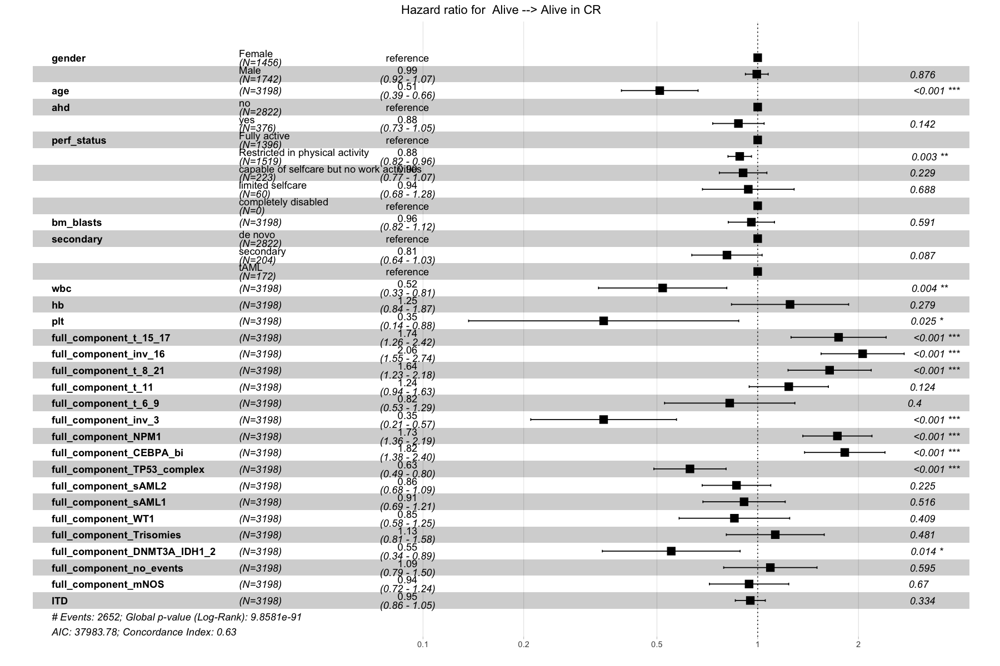

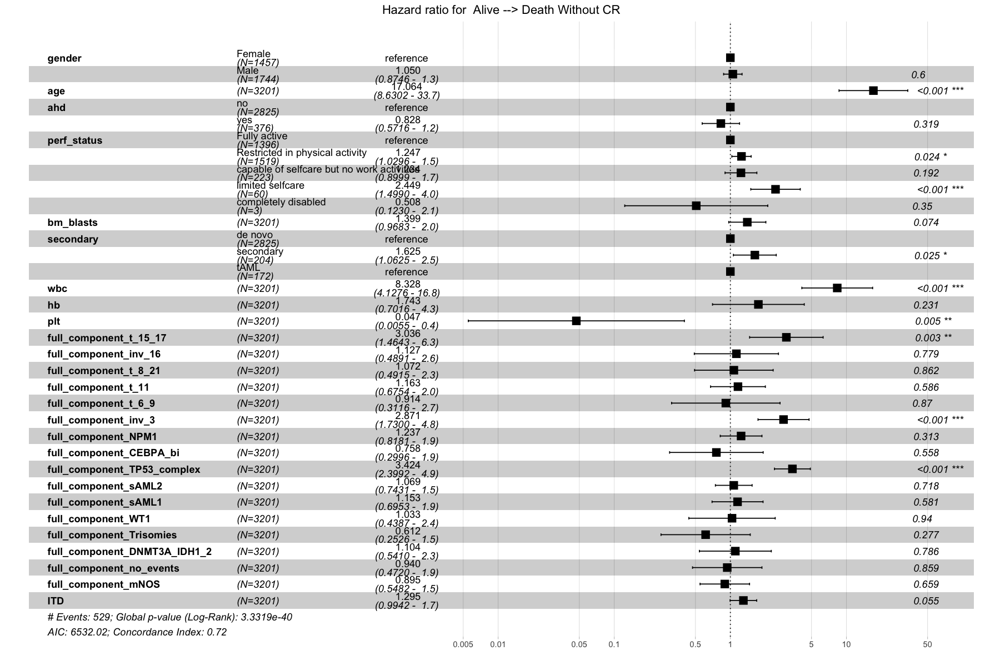

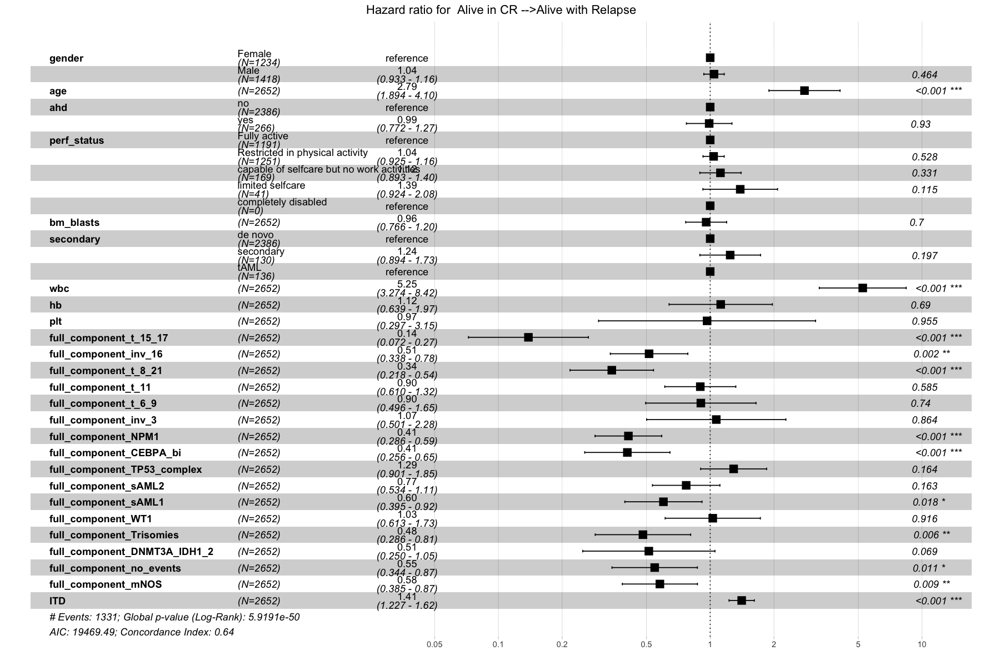

[[1]]

[[2]]

[[3]]

[[4]]

[[5]]


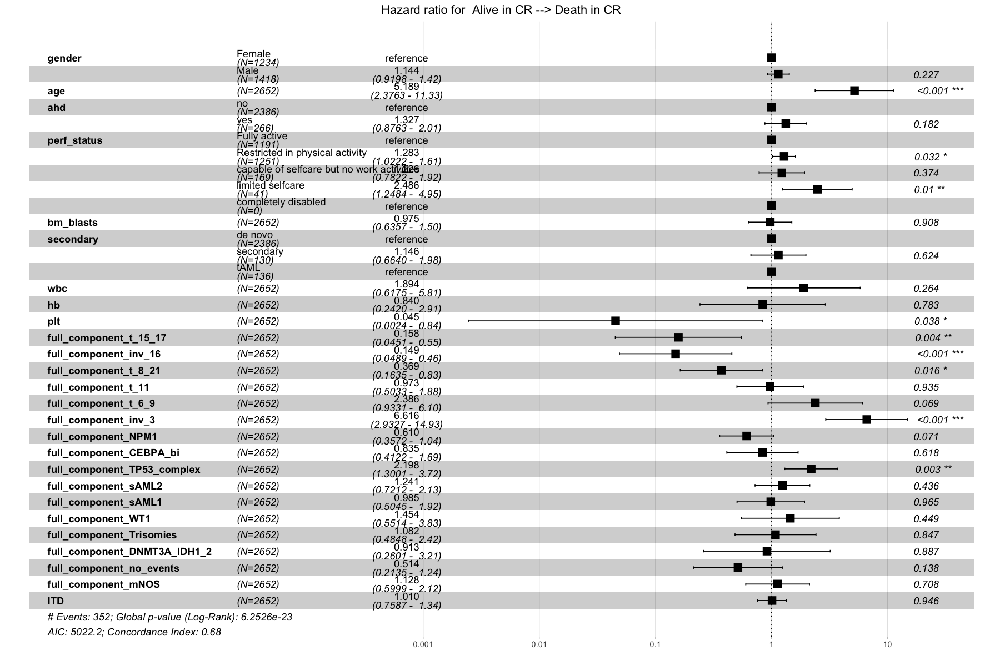

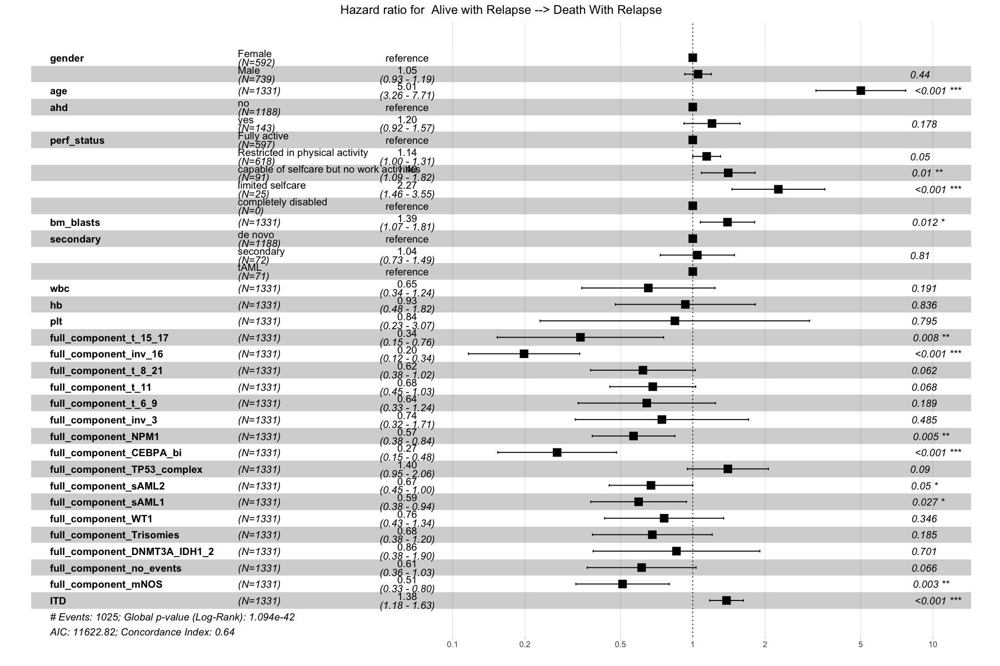

In [11]:
# Normalize Continuous Covariates for interpretation of the pre computed transition hazard ratio

normalized<-function(y) {

  x<-y[!is.na(y)]

  x<-(x - min(x)) / (max(x) - min(x))

  y[!is.na(y)]<-x

  return(y)
  }

set_notebook_plot_size(15,10)
msdata_precomputed <- msdata[!(msdata$trans==1 & msdata$perf_status==4),]  ### Handle perf status =4 for 2 rows in trans 1 that mess up with the ggforest because of one coefficient

msdata_precomputed$gender <- factor(msdata_precomputed$gender,labels=c("Female","Male"))
msdata_precomputed$ahd <- factor(msdata_precomputed$ahd,labels=c("no","yes"))
msdata_precomputed$perf_status <- factor(msdata_precomputed$perf_status,labels=c("Fully active","Restricted in physical activity","capable of selfcare but no work activities","limited selfcare","completely disabled"))
msdata_precomputed$secondary <- factor(msdata_precomputed$secondary,labels=c("de novo","secondary","tAML"))
# msdata_precomputed[,c("secondary")] <- lapply(msdata_precomputed[,c("secondary")],as.factor)


msdata_precomputed[,c("age","bm_blasts","wbc","hb","plt")] <- apply(msdata_precomputed[,c("age","bm_blasts","wbc","hb","plt")],2,normalized)
# msdata_precomputed[,c(clin,demo)] <- apply(msdata_precomputed[,c(clin,demo)],2,normalized)
covariates <- c(demo,clin,comp[comp!="overlap"],"ITD")
form <- "Surv(Tstart, Tstop, status) ~ "
for (co in c(covariates)){
    form <- paste (form,co,sep = " + ")
}

# Plot Forest Global

data_trans <- list()
cox_trans <- list()
plot_forest <- list()
set.seed(17)
for (i in c(1:5)){
    data_trans[[i]] <- msdata_precomputed[msdata_precomputed$trans==i,]
    formula <- form
    set.seed(9)
    if(i %in% c(3,4)){
        data_trans[[i]] <- data_trans[[i]][data_trans[[i]]$perf_status!="completely disabled",]
        #data_trans[[i]]$perf_status <- factor(data_trans[[i]]$perf_status,
                                                 #labels=c("Fully active","Restricted in physical activity","capable of selfcare but no work activities","limited selfcare"))
    }
    cox_trans[[i]] <- coxph(as.formula(formula), data = data_trans[[i]], method = "breslow")
    title <- ifelse(i==1,"Alive --> Alive in CR",
                   ifelse(i==2,"Alive --> Death Without CR",
                         ifelse(i==3,"Alive in CR -->Alive with Relapse",
                               ifelse(i==4,"Alive in CR --> Death in CR","Alive with Relapse --> Death With Relapse"))))
    plot_forest[[i]] <- ggforest(cox_trans[[i]],main=paste("Hazard ratio for ",title),fontsize=1)
}
plot_forest

# **I) Prepare the Model for computation and patient-centric inference.**




In [12]:
msdata <- msprep(data = data, trans = tmat_data, 
                 time = c(NA, "CR", "Relapse","Death_in_CR","Death_in_Relapse","Death_without"), 
                 status = c(NA, "CR_stat", "Relapse_stat", "Death_in_CR_stat",
                            "Death_in_Relapse_stat","Death_without_stat"),
                 keep=c("patient_id","ITD",comp,clin,demo,
                        "NEW_favorable","NEW_intermediate","NEW_adverse",
                       "eln_2017_favorable","eln_2017_intermediate","eln_2017_adverse"))
# Age as time dependent covariate
msdata$age <- msdata$age + msdata$Tstart

msdata <- expand.covs(msdata, covs = c("ITD",comp,clin,demo,
                      "NEW_favorable","NEW_intermediate","NEW_adverse",
                      "eln_2017_favorable","eln_2017_intermediate","eln_2017_adverse"),
                      longnames = FALSE)
expanded_itd <- colnames(msdata)[grepl("ITD.",colnames(msdata))]
expanded_component <- colnames(msdata)[grepl("full_component|overlap",colnames(msdata)) & grepl("\\.",colnames(msdata))]
expanded_clin <- colnames(msdata)[grepl("ahd|perf_status|bm_blasts|secondary|wbc|hb|plt",colnames(msdata)) & grepl("\\.",colnames(msdata))]
expanded_demo <- colnames(msdata)[grepl("gender|age",colnames(msdata)) & grepl("\\.",colnames(msdata))]
expanded_proposal <- colnames(msdata)[grepl("NEW_",colnames(msdata)) & grepl("\\.",colnames(msdata))]
expanded_eln <- colnames(msdata)[grepl("eln_",colnames(msdata)) & grepl("\\.",colnames(msdata))]


## ***1.Prepare full model for patient calculator***

In [13]:
# Prepare Full Model
covariates <- c(demo,clin,comp[comp!="overlap"],"ITD")
form <- "Surv(Tstart, Tstop, status) ~ "
for (co in c(covariates)){
    
    for (sub in c(".1",".2",".3",".4",".5")){
        form <- paste (form,paste(co,sub,sep=""),sep = " + ")
    }
}
form <- paste(form,"+ strata(trans)")
set.seed(9)
cfull <- coxph(as.formula(form), data = msdata, method = "breslow")
cfull

Call:
coxph(formula = as.formula(form), data = msdata, method = "breslow")

                                     coef  exp(coef)   se(coef)      z        p
gender.1                       -5.629e-03  9.944e-01  3.993e-02 -0.141 0.887893
gender.2                        3.103e-02  1.032e+00  9.307e-02  0.333 0.738788
gender.3                        4.845e-02  1.050e+00  5.655e-02  0.857 0.391535
gender.4                        1.388e-01  1.149e+00  1.109e-01  1.252 0.210725
gender.5                        5.117e-02  1.052e+00  6.504e-02  0.787 0.431460
age.1                          -7.847e-03  9.922e-01  1.568e-03 -5.004 5.61e-07
age.2                           3.277e-02  1.033e+00  4.057e-03  8.077 6.62e-16
age.3                           1.212e-02  1.012e+00  2.296e-03  5.279 1.30e-07
age.4                           1.900e-02  1.019e+00  4.640e-03  4.095 4.23e-05
age.5                           1.875e-02  1.019e+00  2.561e-03  7.323 2.42e-13
ahd.1                          -5.606e-01  5

# **II. Get coefficients for all other models to display(intermediate fixed plots in Web app).**

## ***1. Train Risk Proposal Model under cfull_proposal.***

In [14]:
form <- "Surv(Tstart, Tstop, status) ~ "
for (co in expanded_proposal){
        form <- paste (form,co,sep = " + ")
}
form <- paste(form,"+ strata(trans)")
set.seed(9)
cfull_proposal <- coxph(as.formula(form), data = msdata, method = "breslow")
cfull_proposal

Call:
coxph(formula = as.formula(form), data = msdata, method = "breslow")

                       coef exp(coef) se(coef)       z        p
NEW_favorable.1     0.88387   2.42024  0.04929  17.933  < 2e-16
NEW_favorable.2    -0.49336   0.61057  0.12255  -4.026 5.68e-05
NEW_favorable.3    -0.87800   0.41561  0.06793 -12.925  < 2e-16
NEW_favorable.4    -1.21347   0.29716  0.13355  -9.086  < 2e-16
NEW_favorable.5    -0.70993   0.49168  0.08184  -8.674  < 2e-16
NEW_intermediate.1  0.46111   1.58583  0.05064   9.106  < 2e-16
NEW_intermediate.2 -0.50078   0.60606  0.10382  -4.823 1.41e-06
NEW_intermediate.3 -0.40545   0.66668  0.06691  -6.060 1.37e-09
NEW_intermediate.4 -0.60179   0.54783  0.12652  -4.756 1.97e-06
NEW_intermediate.5 -0.24678   0.78131  0.07377  -3.345 0.000822
NEW_adverse.1            NA        NA  0.00000      NA       NA
NEW_adverse.2            NA        NA  0.00000      NA       NA
NEW_adverse.3            NA        NA  0.00000      NA       NA
NEW_adverse.4            NA 

## ***2. Train ELN Model under cfull_eln.***

In [15]:
form <- "Surv(Tstart, Tstop, status) ~ "
for (co in expanded_eln){
        form <- paste (form,co,sep = " + ")
}
form <- paste(form,"+ strata(trans)")
set.seed(9)
cfull_eln <- coxph(as.formula(form), data = msdata, method = "breslow")
cfull_eln

Call:
coxph(formula = as.formula(form), data = msdata, method = "breslow")

                            coef exp(coef) se(coef)       z        p
eln_2017_favorable.1     0.84027   2.31699  0.04683  17.941  < 2e-16
eln_2017_favorable.2    -0.30180   0.73949  0.11467  -2.632  0.00849
eln_2017_favorable.3    -0.67705   0.50812  0.06474 -10.459  < 2e-16
eln_2017_favorable.4    -1.18640   0.30532  0.12561  -9.445  < 2e-16
eln_2017_favorable.5    -0.52042   0.59427  0.07598  -6.850 7.41e-12
eln_2017_intermediate.1  0.28416   1.32865  0.05317   5.344 9.09e-08
eln_2017_intermediate.2 -0.53594   0.58512  0.10936  -4.901 9.55e-07
eln_2017_intermediate.3 -0.18636   0.82998  0.07054  -2.642  0.00824
eln_2017_intermediate.4 -0.55407   0.57461  0.13417  -4.129 3.64e-05
eln_2017_intermediate.5 -0.15903   0.85297  0.07741  -2.054  0.03993
eln_2017_adverse.1            NA        NA  0.00000      NA       NA
eln_2017_adverse.2            NA        NA  0.00000      NA       NA
eln_2017_adverse.3         

## ***3. Train Component model under cfull_comp.***

In [16]:
form <- "Surv(Tstart, Tstop, status) ~ "
for (co in c(expanded_component,expanded_itd)){
        form <- paste (form,co,sep = " + ")
}
form <- paste(form,"+ strata(trans)")
set.seed(9)
cfull_comp <- coxph(as.formula(form), data = msdata, method = "breslow")
cfull_comp

Call:
coxph(formula = as.formula(form), data = msdata, method = "breslow")

                                     coef  exp(coef)   se(coef)      z        p
full_component_t_15_17.1        1.115e+00  3.051e+00  6.055e-01  1.842  0.06547
full_component_t_15_17.2       -1.818e-01  8.338e-01  8.129e-01 -0.224  0.82302
full_component_t_15_17.3       -1.112e+00  3.290e-01  7.851e-01 -1.416  0.15680
full_component_t_15_17.4       -1.262e+01  3.319e-06  2.392e+02 -0.053  0.95793
full_component_t_15_17.5       -2.573e+00  7.632e-02  1.084e+00 -2.374  0.01758
full_component_inv_16.1         1.270e+00  3.562e+00  5.989e-01  2.121  0.03390
full_component_inv_16.2        -1.070e+00  3.431e-01  8.347e-01 -1.282  0.19997
full_component_inv_16.3         3.334e-01  1.396e+00  7.439e-01  0.448  0.65402
full_component_inv_16.4        -1.275e+01  2.902e-06  2.392e+02 -0.053  0.95748
full_component_inv_16.5        -3.273e+00  3.789e-02  1.040e+00 -3.146  0.00165
full_component_t_8_21.1         1.087e+00  2

# **II) Prepare all saved multistate and probability plots**

## **1. Create and Save one favorable Proposal, one intermediate proposal and one adverse proposal to display for average patient in specific risk proposal**
## **The probability transitions are presaved to gain time because it does not depend on patient's covariate.**

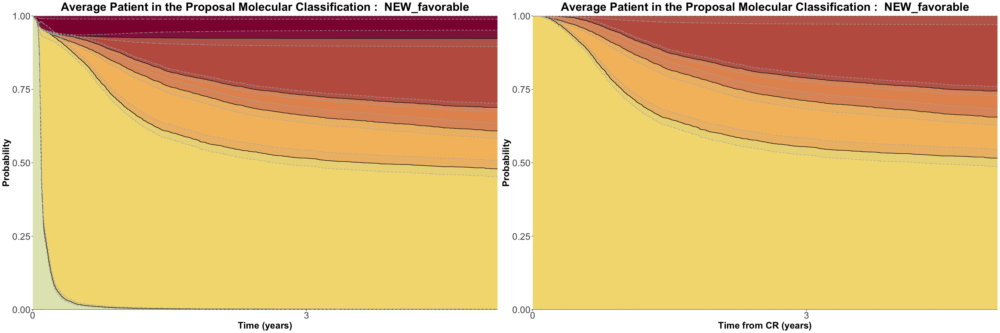

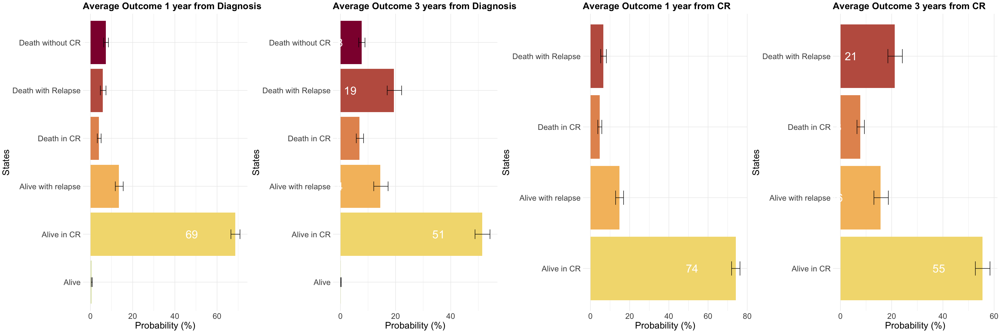

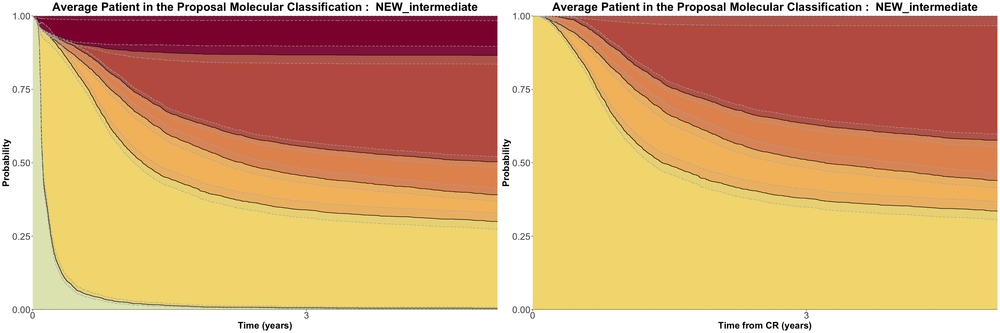

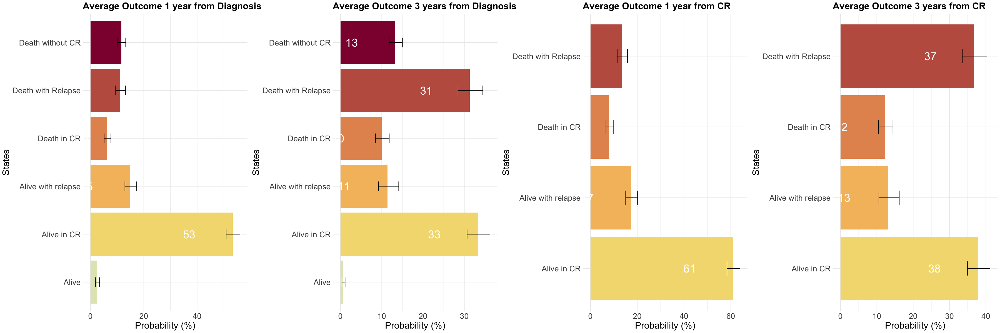

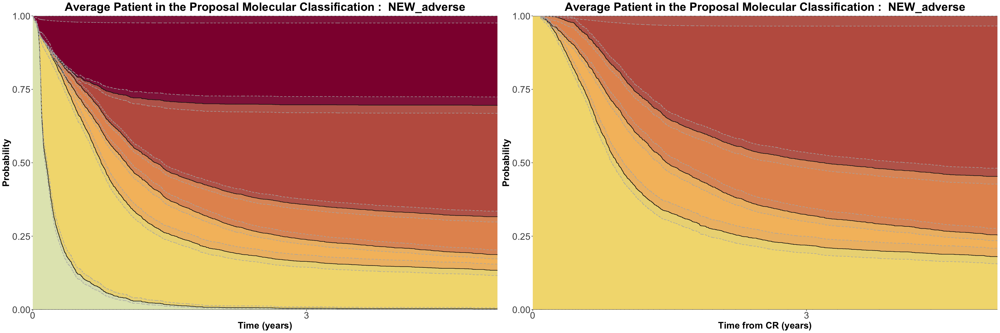

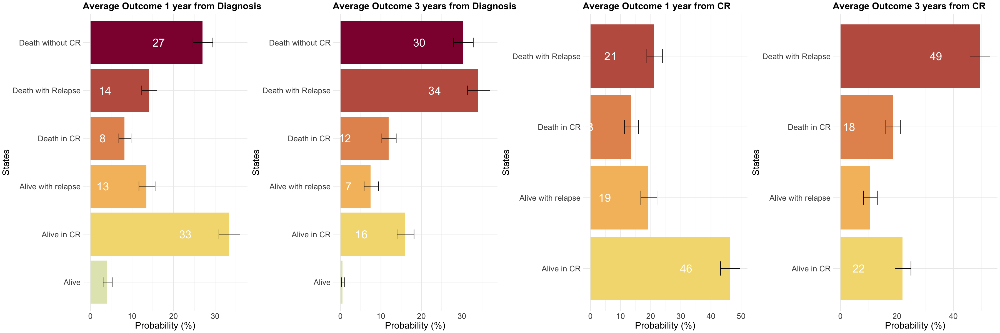

In [17]:
set_notebook_plot_size(30,10)
for (j in c("NEW_favorable","NEW_intermediate","NEW_adverse")){ 
    # pdf(paste("Output_Patient/temp_plot_",j,".pdf",sep=""),width=30,height=7)
    par(mfrow=c(1,2))
    tmp_data <- rbind(msdata,rep( NA, ncol( msdata ) ))
    patA_proposal <- tmp_data[rep(nrow(tmp_data),each=5),c("NEW_favorable","NEW_intermediate","NEW_adverse")]
    patA_proposal[,c("NEW_favorable","NEW_intermediate","NEW_adverse")] <-0
    
    patA_proposal[,j] <- 1

    patA_proposal$trans <- 1:5
    attr(patA_proposal, "trans") <- tmat_data

    patA_proposal <- expand.covs(patA_proposal, c("NEW_favorable","NEW_intermediate","NEW_adverse"), longnames = FALSE)
    patA_proposal$strata <- patA_proposal$trans
    msfA_proposal <- msfit(cfull_proposal, patA_proposal, trans = tmat_data)
    ord <- c(1,2,3,4,5,6)
    
    # we save the computations through ptA_proposal_favorable,intermediate and adverse
    if(j=="NEW_favorable"){
        ptA_proposal_favorable <- probtrans(msfA_proposal, predt = 0,variance=T)
    } else if(j=="NEW_intermediate"){
        ptA_proposal_intermediate <- probtrans(msfA_proposal, predt = 0,variance=T)
    } else {
        ptA_proposal_adverse <- probtrans(msfA_proposal, predt = 0,variance=T) 
    }
    
    ptA_proposal <- probtrans(msfA_proposal, predt = 0,variance=T)
        
    proposal_patient <- j
    
    probtrans_plot_list  <- list()
    for (i in 1:2){
        if(i==1){
            colors <- statecols[1:6]
        } else{
            colors <- statecols[2:5]
        }
        probtrans_plot_list[[i]] <- plot_probtrans_Conf_Interval(ptA_proposal,colors = colors, from=i, ord = ord,xlim=c(0,5.1),
                                     main = paste("Average Patient in the Proposal Molecular Classification : ",proposal_patient),
                                    xlab=ifelse(i==1,"Time (years)","Time from CR (years)"))
             
    }
    grid.arrange(probtrans_plot_list[[1]],probtrans_plot_list[[2]],nrow=1)
    ptrans1_proposal <- data.frame(States=c("Alive","Alive in CR","Alive with relapse","Death in CR","Death with Relapse","Death without CR"),
                  proba=unlist(ptA_proposal[[1]][ptA_proposal[[1]]$time>=1 ,c("pstate1","pstate2","pstate3","pstate4","pstate5","pstate6")][1,]*100,use.names = F),
                  se=unlist(ptA_proposal[[1]][ptA_proposal[[1]]$time>=1 ,c("se1","se2","se3","se4","se5","se6")][1,]*100,use.names = F)            )
    diagnosis_1_proposal <- ggplot(ptrans1_proposal,aes(x=States,y=proba)) + geom_bar(stat="identity", fill=statecols)+
    geom_errorbar(aes(ymin=exp(log(proba) - crit * se / proba), ymax=exp(log(proba) + crit * se / proba)),
                      width=.2,                    # Width of the error bars
                      position=position_dodge(.9))+
      geom_text(aes(label=round(proba,0)), vjust=0.5,hjust=4, color="white", size=8.5,face="bold")+ coord_flip()+ylab("Probability (%)")+
      theme_minimal() + theme(axis.text=element_text(size=17),axis.title=element_text(size=20),plot.title=element_text(size=20,face="bold")) +
    ggtitle ("Average Outcome 1 year from Diagnosis")

    ptrans3_proposal <- data.frame(States=c("Alive","Alive in CR","Alive with relapse","Death in CR","Death with Relapse","Death without CR"),
                  proba=unlist(ptA_proposal[[1]][ptA_proposal[[1]]$time>=3 ,c("pstate1","pstate2","pstate3","pstate4","pstate5","pstate6")][1,]*100,use.names = F),
                  se=unlist(ptA_proposal[[1]][ptA_proposal[[1]]$time>=3 ,c("se1","se2","se3","se4","se5","se6")][1,]*100,use.names = F)            )
    diagnosis_3_proposal <- ggplot(ptrans3_proposal,aes(x=States,y=proba)) + geom_bar(stat="identity", fill=statecols)+
    geom_errorbar(aes(ymin=exp(log(proba) - crit * se / proba), ymax=exp(log(proba) + crit * se / proba)),
                      width=.2,                    # Width of the error bars
                      position=position_dodge(.9))+
      geom_text(aes(label=round(proba,0)), vjust=0.5,hjust=4, color="white", size=8.5,face="bold")+ coord_flip()+ylab("Probability (%)")+
      theme_minimal() + theme(axis.text=element_text(size=17),axis.title=element_text(size=20),plot.title=element_text(size=20,face="bold")) +
    ggtitle ("Average Outcome 3 years from Diagnosis")

    ptrans1_CR_proposal <- data.frame(States=c("Alive in CR","Alive with relapse","Death in CR","Death with Relapse"),
                  proba=unlist(ptA_proposal[[2]][ptA_proposal[[2]]$time>=1 ,c("pstate2","pstate3","pstate4","pstate5")][1,]*100,use.names = F),
                  se=unlist(ptA_proposal[[2]][ptA_proposal[[2]]$time>=1 ,c("se2","se3","se4","se5")][1,]*100,use.names = F)            )
    CR_1_proposal <- ggplot(ptrans1_CR_proposal,aes(x=States,y=proba)) + geom_bar(stat="identity", fill=statecols[2:5])+
    geom_errorbar(aes(ymin=exp(log(proba) - crit * se / proba), ymax=exp(log(proba) + crit * se / proba)),
                      width=.2,                    # Width of the error bars
                      position=position_dodge(.9))+
      geom_text(aes(label=round(proba,0)), vjust=0.5,hjust=4, color="white", size=8.5,face="bold")+ coord_flip()+ylab("Probability (%)")+
      theme_minimal() + theme(axis.text=element_text(size=17),axis.title=element_text(size=20),plot.title=element_text(size=20,face="bold")) +
    ggtitle ("Average Outcome 1 year from CR")

    ptrans3_CR_proposal <- data.frame(States=c("Alive in CR","Alive with relapse","Death in CR","Death with Relapse"),
                  proba=unlist(ptA_proposal[[2]][ptA_proposal[[2]]$time>=3 ,c("pstate2","pstate3","pstate4","pstate5")][1,]*100,use.names = F),
                  se=unlist(ptA_proposal[[2]][ptA_proposal[[2]]$time>=3 ,c("se2","se3","se4","se5")][1,]*100,use.names = F)            )
    CR_3_proposal <- ggplot(ptrans3_CR_proposal,aes(x=States,y=proba)) + geom_bar(stat="identity", fill=statecols[2:5])+
    geom_errorbar(aes(ymin=exp(log(proba) - crit * se / proba), ymax=exp(log(proba) + crit * se / proba)),
                      width=.2,                    # Width of the error bars
                      position=position_dodge(.9))+
      geom_text(aes(label=round(proba,0)), vjust=0.5,hjust=4, color="white", size=8.5,face="bold")+ coord_flip()+ylab("Probability (%)")+
      theme_minimal() + theme(axis.text=element_text(size=17),axis.title=element_text(size=20),plot.title=element_text(size=20,face="bold")) +
    ggtitle ("Average Outcome 3 years from CR")


    grid.arrange(diagnosis_1_proposal,diagnosis_3_proposal,CR_1_proposal,CR_3_proposal,nrow=1)
    # dev.off()
}


## **2. Create and Save one favorable ELN, one intermediate ELN and one adverse ELN to display for average patient in specific risk ELN**
## **The probability transitions are presaved to gain time because it does not depend on patient's covariate.**

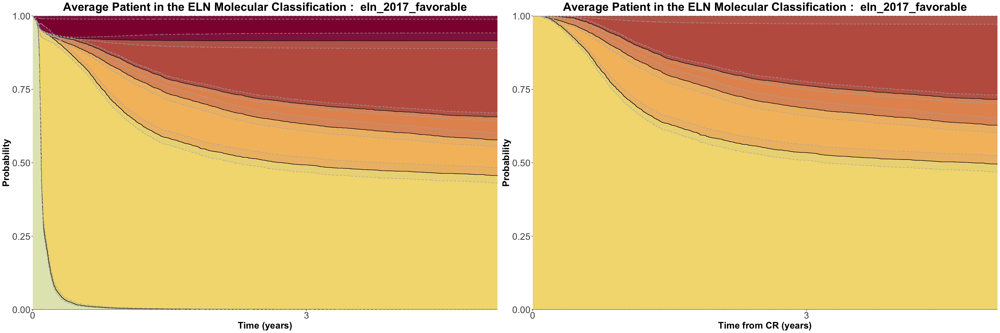

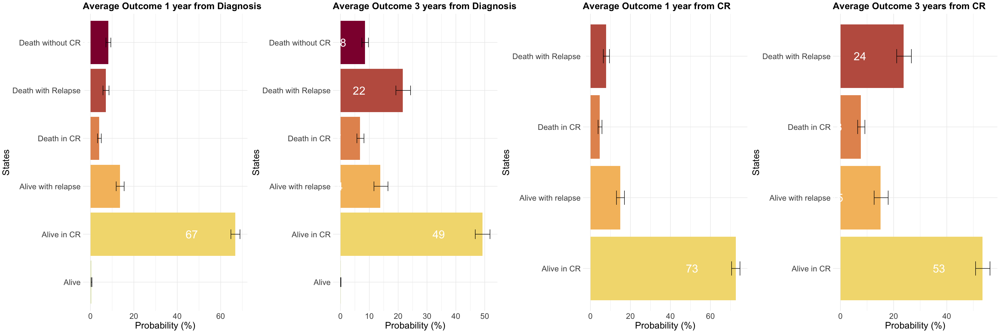

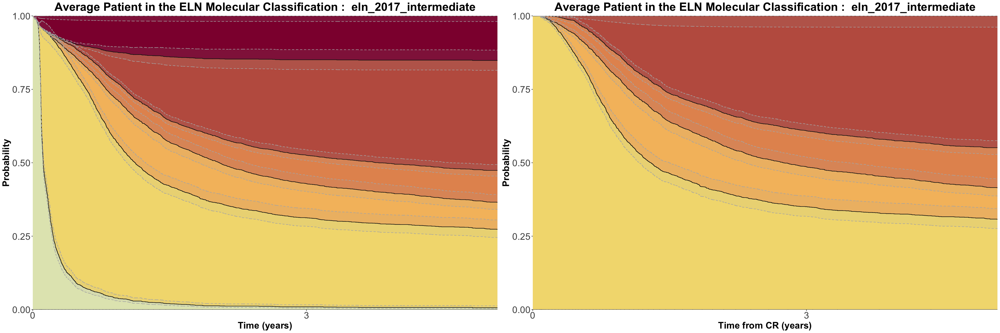

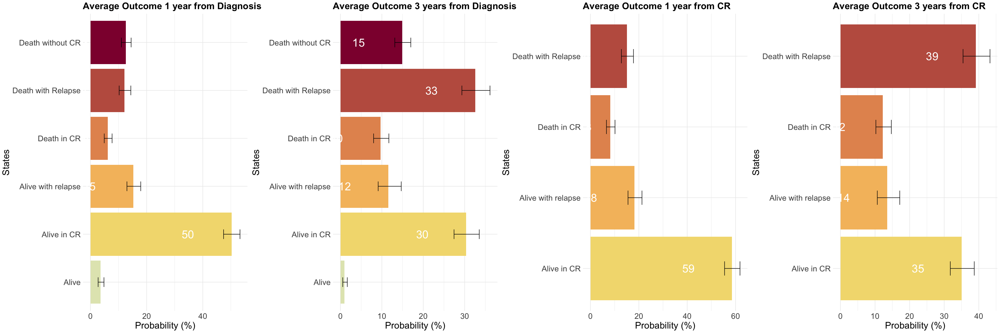

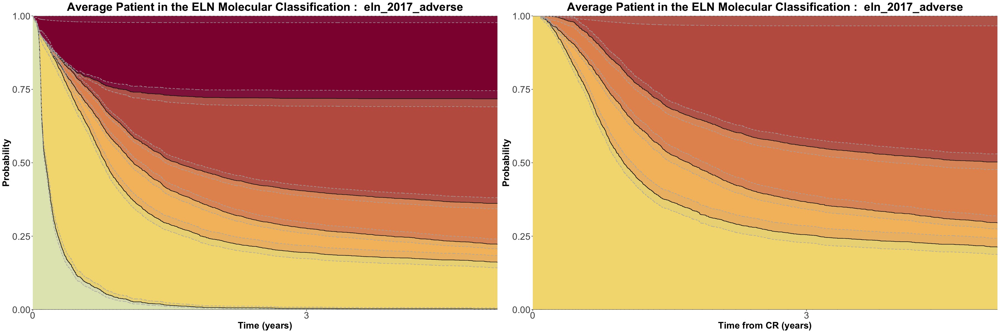

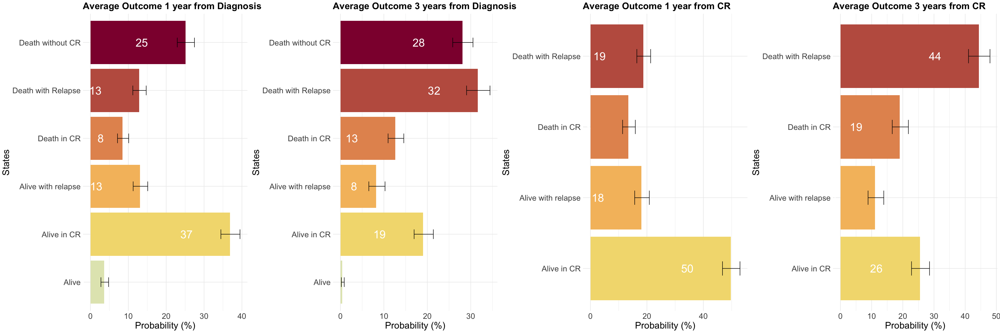

In [18]:
for (j in c("eln_2017_favorable","eln_2017_intermediate","eln_2017_adverse")){ 
    # pdf(paste("Output_Patient/temp_plot_",j,".pdf",sep=""),width=30,height=7)
    par(mfrow=c(1,2))
    tmp_data <- rbind(msdata,rep( NA, ncol( msdata ) ))
    patA_eln <- tmp_data[rep(nrow(tmp_data),each=5),
                              c("eln_2017_favorable","eln_2017_intermediate","eln_2017_adverse")]
    patA_eln[,c("eln_2017_favorable","eln_2017_intermediate","eln_2017_adverse")] <- 0
    
    patA_eln[,j] <- 1

    patA_eln$trans <- 1:5
    attr(patA_eln, "trans") <- tmat_data

    patA_eln <- expand.covs(patA_eln, 
                                 c("eln_2017_favorable","eln_2017_intermediate","eln_2017_adverse"),
                                 longnames = FALSE)
    patA_eln$strata <- patA_eln$trans
    msfA_eln <- msfit(cfull_eln, patA_eln, trans = tmat_data)
    ord <- c(1,2,3,4,5,6)
    
    # we save the computations through ptA_eln_favorable,intermediate and adverse
    if(j=="eln_2017_favorable"){
        ptA_eln_favorable <- probtrans(msfA_eln, predt = 0,variance=T)
    } else if(j=="eln_2017_intermediate"){
        ptA_eln_intermediate <- probtrans(msfA_eln, predt = 0,variance=T)
    } else {
        ptA_eln_adverse <- probtrans(msfA_eln, predt = 0,variance=T) 
    }
    
    ptA_eln <- probtrans(msfA_eln, predt = 0,variance=T)
        
    eln_patient <- j
    
    probtrans_plot_list  <- list()
    for (i in 1:2){
        if(i==1){
            colors <- statecols[1:6]
        } else{
            colors <- statecols[2:5]
        }
        probtrans_plot_list[[i]] <- plot_probtrans_Conf_Interval(ptA_eln,colors = colors, from=i, ord = ord,xlim=c(0,5.1),
                                     main = paste("Average Patient in the ELN Molecular Classification : ",eln_patient),
                                    xlab=ifelse(i==1,"Time (years)","Time from CR (years)"))
             
    }
    grid.arrange(probtrans_plot_list[[1]],probtrans_plot_list[[2]],nrow=1)
    ptrans1_eln <- data.frame(States=c("Alive","Alive in CR","Alive with relapse","Death in CR","Death with Relapse","Death without CR"),
                  proba=unlist(ptA_eln[[1]][ptA_eln[[1]]$time>=1 ,c("pstate1","pstate2","pstate3","pstate4","pstate5","pstate6")][1,]*100,use.names = F),
                  se=unlist(ptA_eln[[1]][ptA_eln[[1]]$time>=1 ,c("se1","se2","se3","se4","se5","se6")][1,]*100,use.names = F)            )
    diagnosis_1_eln <- ggplot(ptrans1_eln,aes(x=States,y=proba)) + geom_bar(stat="identity", fill=statecols)+
    geom_errorbar(aes(ymin=exp(log(proba) - crit * se / proba), ymax=exp(log(proba) + crit * se / proba)),
                      width=.2,                    # Width of the error bars
                      position=position_dodge(.9))+
      geom_text(aes(label=round(proba,0)), vjust=0.5,hjust=4, color="white", size=8.5,face="bold")+ coord_flip()+ylab("Probability (%)")+
      theme_minimal() + theme(axis.text=element_text(size=17),axis.title=element_text(size=20),plot.title=element_text(size=20,face="bold")) +
    ggtitle ("Average Outcome 1 year from Diagnosis")

    ptrans3_eln <- data.frame(States=c("Alive","Alive in CR","Alive with relapse","Death in CR","Death with Relapse","Death without CR"),
                  proba=unlist(ptA_eln[[1]][ptA_eln[[1]]$time>=3 ,c("pstate1","pstate2","pstate3","pstate4","pstate5","pstate6")][1,]*100,use.names = F),
                  se=unlist(ptA_eln[[1]][ptA_eln[[1]]$time>=3 ,c("se1","se2","se3","se4","se5","se6")][1,]*100,use.names = F)            )
    diagnosis_3_eln <- ggplot(ptrans3_eln,aes(x=States,y=proba)) + geom_bar(stat="identity", fill=statecols)+
    geom_errorbar(aes(ymin=exp(log(proba) - crit * se / proba), ymax=exp(log(proba) + crit * se / proba)),
                      width=.2,                    # Width of the error bars
                      position=position_dodge(.9))+
      geom_text(aes(label=round(proba,0)), vjust=0.5,hjust=4, color="white", size=8.5,face="bold")+ coord_flip()+ylab("Probability (%)")+
      theme_minimal() + theme(axis.text=element_text(size=17),axis.title=element_text(size=20),plot.title=element_text(size=20,face="bold")) +
    ggtitle ("Average Outcome 3 years from Diagnosis")

    ptrans1_CR_eln <- data.frame(States=c("Alive in CR","Alive with relapse","Death in CR","Death with Relapse"),
                  proba=unlist(ptA_eln[[2]][ptA_eln[[2]]$time>=1 ,c("pstate2","pstate3","pstate4","pstate5")][1,]*100,use.names = F),
                  se=unlist(ptA_eln[[2]][ptA_eln[[2]]$time>=1 ,c("se2","se3","se4","se5")][1,]*100,use.names = F)            )
    CR_1_eln <- ggplot(ptrans1_CR_eln,aes(x=States,y=proba)) + geom_bar(stat="identity", fill=statecols[2:5])+
    geom_errorbar(aes(ymin=exp(log(proba) - crit * se / proba), ymax=exp(log(proba) + crit * se / proba)),
                      width=.2,                    # Width of the error bars
                      position=position_dodge(.9))+
      geom_text(aes(label=round(proba,0)), vjust=0.5,hjust=4, color="white", size=8.5,face="bold")+ coord_flip()+ylab("Probability (%)")+
      theme_minimal() + theme(axis.text=element_text(size=17),axis.title=element_text(size=20),plot.title=element_text(size=20,face="bold")) +
    ggtitle ("Average Outcome 1 year from CR")

    ptrans3_CR_eln <- data.frame(States=c("Alive in CR","Alive with relapse","Death in CR","Death with Relapse"),
                  proba=unlist(ptA_eln[[2]][ptA_eln[[2]]$time>=3 ,c("pstate2","pstate3","pstate4","pstate5")][1,]*100,use.names = F),
                  se=unlist(ptA_eln[[2]][ptA_eln[[2]]$time>=3 ,c("se2","se3","se4","se5")][1,]*100,use.names = F)            )
    CR_3_eln <- ggplot(ptrans3_CR_eln,aes(x=States,y=proba)) + geom_bar(stat="identity", fill=statecols[2:5])+
    geom_errorbar(aes(ymin=exp(log(proba) - crit * se / proba), ymax=exp(log(proba) + crit * se / proba)),
                      width=.2,                    # Width of the error bars
                      position=position_dodge(.9))+
      geom_text(aes(label=round(proba,0)), vjust=0.5,hjust=4, color="white", size=8.5,face="bold")+ coord_flip()+ylab("Probability (%)")+
      theme_minimal() + theme(axis.text=element_text(size=17),axis.title=element_text(size=20),plot.title=element_text(size=20,face="bold")) +
    ggtitle ("Average Outcome 3 years from CR")


    grid.arrange(diagnosis_1_eln,diagnosis_3_eln,CR_1_eln,CR_3_eln,nrow=1)
    # dev.off()
}

## **3. Create and Save 2 plots for each class: one when ITD mutation is present and one when it's not present.**
## **The probability transitions are presaved to gain time because it does not depend on patient's covariate.**


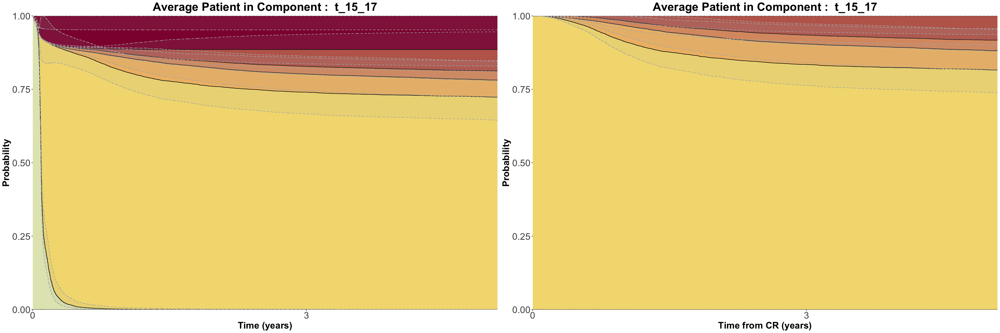

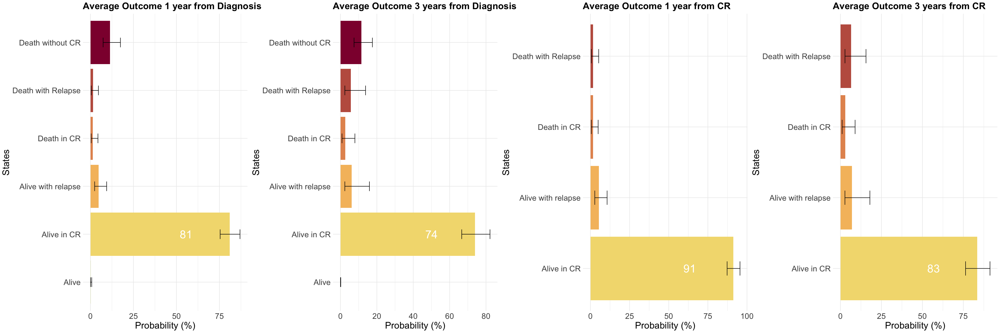

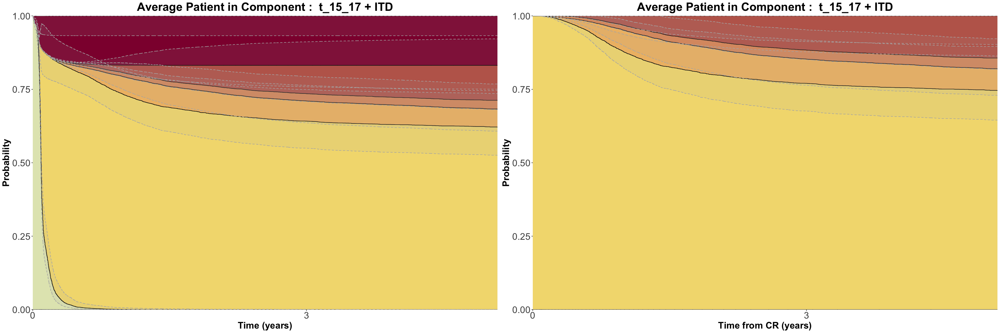

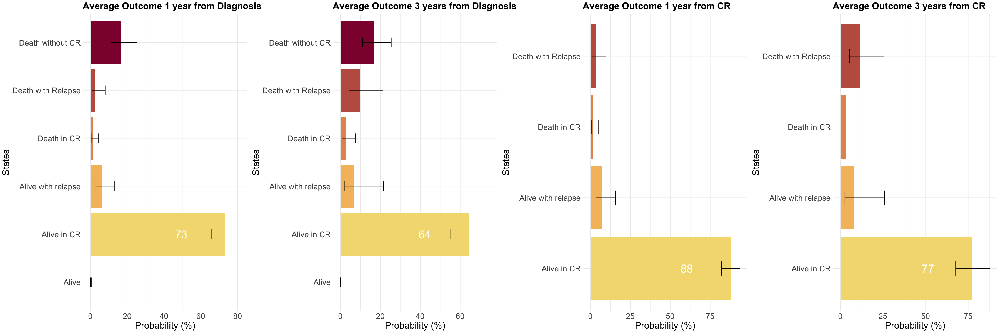

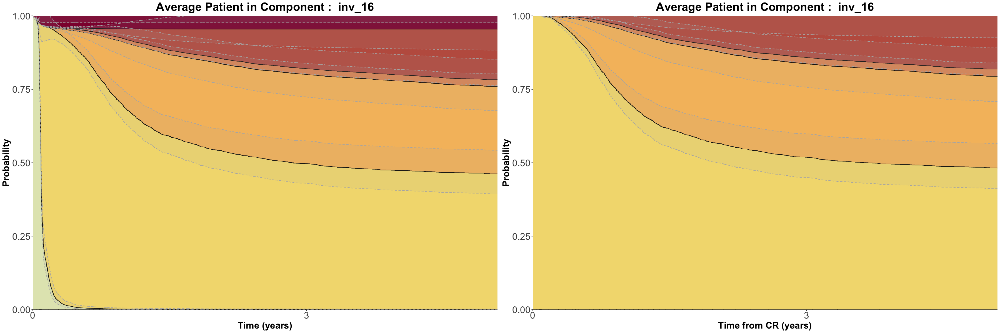

...

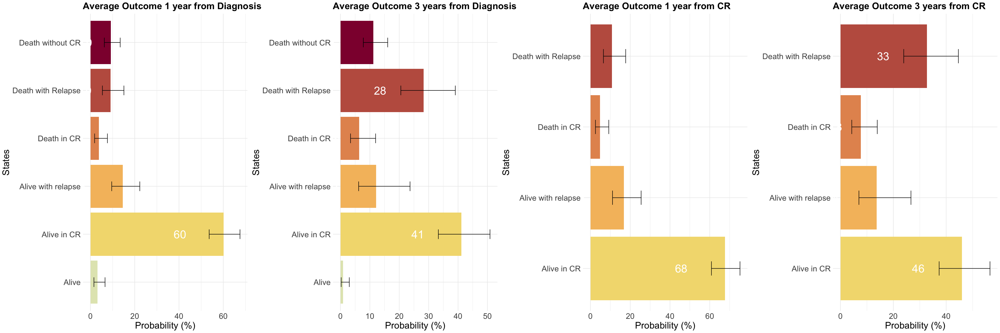

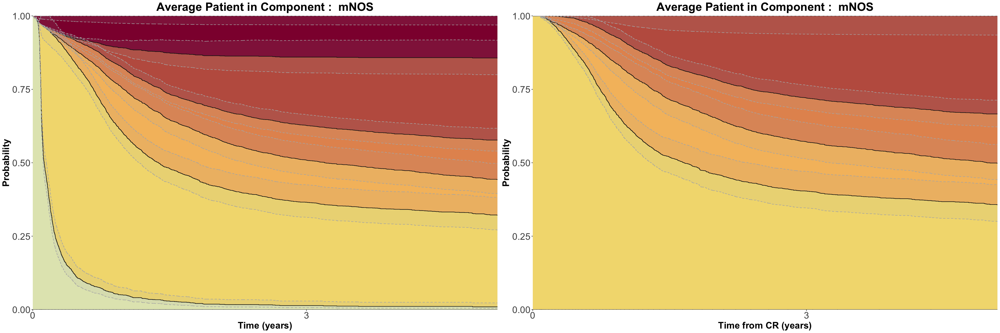

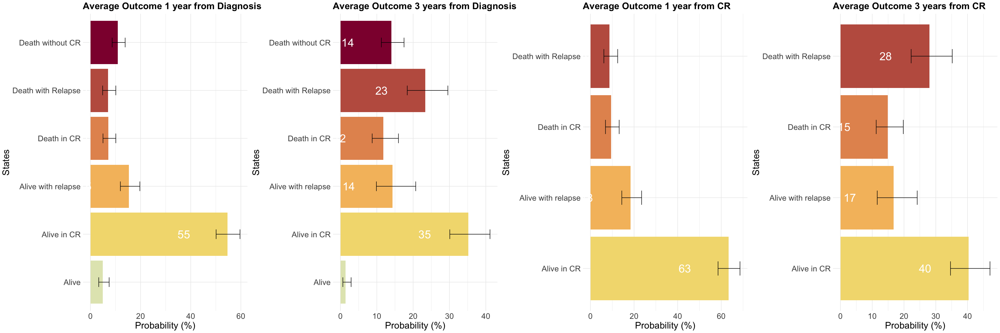

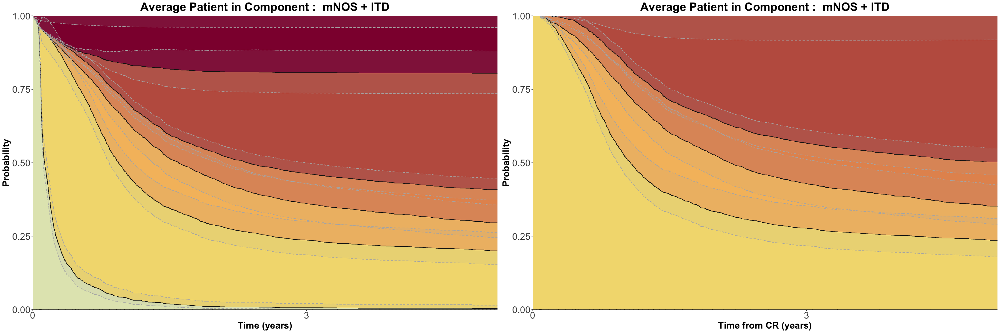

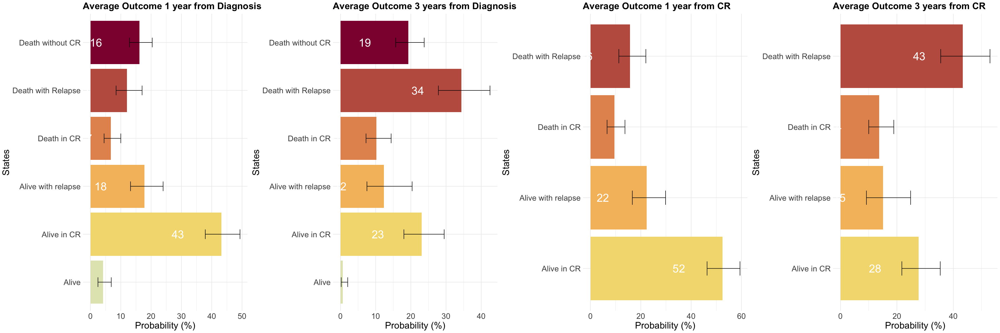

In [19]:
# ITD AND WITHOUT ITD
for (j in c(comp[comp!="overlap"])){ 


    tmp_data <- rbind(msdata,rep( NA, ncol( msdata ) ))
    
    # one version with ITD and one without
    
    patA_comp <- tmp_data[rep(nrow(tmp_data),each=5),
                             c(comp,"ITD")]

    
    patA_comp[,c(comp,"ITD")] <- 0
    
    # Copy patA_comp for ITD
    patA_comp_ITD <- patA_comp
    
    
    # Prepare patA_comp
    patA_comp[,j] <- 1
    patA_comp$trans <- 1:5
    attr(patA_comp, "trans") <- tmat_data
    patA_comp <- expand.covs(patA_comp, 
                                 c(comp,"ITD"),
                                 longnames = FALSE)
    patA_comp$strata <- patA_comp$trans
    msfA_comp <- msfit(cfull_comp, patA_comp, trans = tmat_data)
    
    # Add ITD Patient from patA
    patA_comp_ITD[,j] <- 1
    patA_comp_ITD$ITD <- 1
    patA_comp_ITD$trans <- 1:5
    attr(patA_comp_ITD, "trans") <- tmat_data    
    patA_comp_ITD <- expand.covs(patA_comp_ITD, 
                                 c(comp,"ITD"),
                                 longnames = FALSE)
    patA_comp_ITD$strata <- patA_comp_ITD$trans
    msfA_comp_ITD <- msfit(cfull_comp, patA_comp_ITD, trans = tmat_data)
    
    
    ord <- c(1,2,3,4,5,6)
    
    # we save the computations for each component and component+ITD
    
    if(j=="full_component_t_15_17"){
        ptA_full_component_t_15_17 <- probtrans(msfA_comp, predt = 0,variance=T)
        ptA_full_component_t_15_17_ITD <- probtrans(msfA_comp_ITD, predt = 0,variance=T)
    } else if(j=="full_component_inv_16"){
        ptA_full_component_inv_16 <- probtrans(msfA_comp, predt = 0,variance=T)
        ptA_full_component_inv_16_ITD <- probtrans(msfA_comp_ITD, predt = 0,variance=T)
    } else if(j=="full_component_t_8_21"){
        ptA_full_component_t_8_21 <- probtrans(msfA_comp, predt = 0,variance=T) 
        ptA_full_component_t_8_21_ITD <- probtrans(msfA_comp_ITD, predt = 0,variance=T) 
    } else if(j=="full_component_t_11"){
        ptA_full_component_t_11 <- probtrans(msfA_comp, predt = 0,variance=T) 
        ptA_full_component_t_11_ITD <- probtrans(msfA_comp_ITD, predt = 0,variance=T) 
    } else if(j=="full_component_t_6_9"){
        ptA_full_component_t_6_9 <- probtrans(msfA_comp, predt = 0,variance=T)
        ptA_full_component_t_6_9_ITD <- probtrans(msfA_comp_ITD, predt = 0,variance=T)
    } else if(j=="full_component_inv_3"){
        ptA_full_component_inv_3 <- probtrans(msfA_comp, predt = 0,variance=T)
        ptA_full_component_inv_3_ITD <- probtrans(msfA_comp_ITD, predt = 0,variance=T)
    } else if(j=="full_component_Trisomies"){
        ptA_full_component_Trisomies <- probtrans(msfA_comp, predt = 0,variance=T)
        ptA_full_component_Trisomies_ITD <- probtrans(msfA_comp_ITD, predt = 0,variance=T)
    } else if(j=="full_component_TP53_complex"){
        ptA_full_component_TP53_complex <- probtrans(msfA_comp, predt = 0,variance=T)
        ptA_full_component_TP53_complex_ITD <- probtrans(msfA_comp_ITD, predt = 0,variance=T)
    } else if(j=="full_component_NPM1"){
        ptA_full_component_NPM1 <- probtrans(msfA_comp, predt = 0,variance=T)
        ptA_full_component_NPM1_ITD <- probtrans(msfA_comp_ITD, predt = 0,variance=T)
    } else if(j=="full_component_CEBPA_bi"){
        ptA_full_component_CEBPA_bi <- probtrans(msfA_comp, predt = 0,variance=T)
        ptA_full_component_CEBPA_bi_ITD <- probtrans(msfA_comp_ITD, predt = 0,variance=T)
    } else if(j=="full_component_DNMT3A_IDH1_2"){
        ptA_full_component_DNMT3A_IDH1_2 <- probtrans(msfA_comp, predt = 0,variance=T)
        ptA_full_component_DNMT3A_IDH1_2_ITD <- probtrans(msfA_comp_ITD, predt = 0,variance=T)
    } else if(j=="full_component_WT1"){
        ptA_full_component_WT1 <- probtrans(msfA_comp, predt = 0,variance=T)
        ptA_full_component_WT1_ITD <- probtrans(msfA_comp_ITD, predt = 0,variance=T)
    } else if(j=="full_component_sAML2"){
        ptA_full_component_sAML2 <- probtrans(msfA_comp, predt = 0,variance=T)
        ptA_full_component_sAML2_ITD <- probtrans(msfA_comp_ITD, predt = 0,variance=T)
    } else if(j=="full_component_sAML1"){
        ptA_full_component_sAML1 <- probtrans(msfA_comp, predt = 0,variance=T) 
        ptA_full_component_sAML1_ITD <- probtrans(msfA_comp_ITD, predt = 0,variance=T) 
    } else if(j=="full_component_mNOS"){
        ptA_full_component_mNOS <- probtrans(msfA_comp, predt = 0,variance=T)
        ptA_full_component_mNOS_ITD <- probtrans(msfA_comp_ITD, predt = 0,variance=T)
    } else if(j=="full_component_no_events"){
        ptA_full_component_no_events <- probtrans(msfA_comp, predt = 0,variance=T)
        ptA_full_component_no_events_ITD <- probtrans(msfA_comp, predt = 0,variance=T) # can not have ITD
    }
    
    
    ptA_comp <- probtrans(msfA_comp, predt = 0,variance=T)
    ptA_comp_ITD <- probtrans(msfA_comp_ITD, predt = 0,variance=T)   
        
    comp_patient <- str_remove(j,"full_component_")
    comp_patient_ITD <- paste(str_remove(j,"full_component_"),"+ ITD")
   for (k in 1:2){
       if(k==1){
           patient <- ptA_comp
           name <- comp_patient
           pdf_name <- paste("Output_Patient/temp_plot_",j,".pdf",sep="")
       } else{
           if(j=="full_component_no_events"){   ## special case because no ITD anyway if component is no events
               patient <- ptA_comp
               name <- comp_patient
               pdf_name <- paste("Output_Patient/temp_plot_",j,".pdf",sep="")
           }else{
               patient <- ptA_comp_ITD
               name <- comp_patient_ITD
               pdf_name <- paste("Output_Patient/temp_plot_",j,"_ITD.pdf",sep="")
            }
       }
        # pdf(pdf_name,width=30,height=7)       
        probtrans_plot_list  <- list()
        for (i in 1:2){
            if(i==1){
                colors <- statecols[1:6]
            } else{
                colors <- statecols[2:5]
            }
            probtrans_plot_list[[i]] <- plot_probtrans_Conf_Interval(patient,colors = colors, from=i, ord = ord,xlim=c(0,5.1),
                                         main = paste("Average Patient in Component : ",name),
                                        xlab=ifelse(i==1,"Time (years)","Time from CR (years)"))
        }
        grid.arrange(probtrans_plot_list[[1]],probtrans_plot_list[[2]],nrow=1)
       
        if(k==1){
            ptrans1_comp <- data.frame(States=c("Alive","Alive in CR","Alive with relapse","Death in CR","Death with Relapse","Death without CR"),
                  proba=unlist(patient[[1]][patient[[1]]$time>=1 ,c("pstate1","pstate2","pstate3","pstate4","pstate5","pstate6")][1,]*100,use.names = F),
                  se=unlist(patient[[1]][patient[[1]]$time>=1 ,c("se1","se2","se3","se4","se5","se6")][1,]*100,use.names = F)            )
            diagnosis_1_comp <- ggplot(ptrans1_comp,aes(x=States,y=proba)) + geom_bar(stat="identity", fill=statecols)+
            geom_errorbar(aes(ymin=exp(log(proba) - crit * se / proba), ymax=exp(log(proba) + crit * se / proba)),
                              width=.2,                    # Width of the error bars
                              position=position_dodge(.9))+
              geom_text(aes(label=round(proba,0)), vjust=0.5,hjust=4, color="white", size=8.5,face="bold")+ coord_flip()+ylab("Probability (%)")+
              theme_minimal() + theme(axis.text=element_text(size=17),axis.title=element_text(size=20),plot.title=element_text(size=20,face="bold")) +
            ggtitle ("Average Outcome 1 year from Diagnosis")

            ptrans3_comp <- data.frame(States=c("Alive","Alive in CR","Alive with relapse","Death in CR","Death with Relapse","Death without CR"),
                          proba=unlist(patient[[1]][patient[[1]]$time>=3 ,c("pstate1","pstate2","pstate3","pstate4","pstate5","pstate6")][1,]*100,use.names = F),
                          se=unlist(patient[[1]][patient[[1]]$time>=3 ,c("se1","se2","se3","se4","se5","se6")][1,]*100,use.names = F)            )
            diagnosis_3_comp <- ggplot(ptrans3_comp,aes(x=States,y=proba)) + geom_bar(stat="identity", fill=statecols)+
            geom_errorbar(aes(ymin=exp(log(proba) - crit * se / proba), ymax=exp(log(proba) + crit * se / proba)),
                              width=.2,                    # Width of the error bars
                              position=position_dodge(.9))+
              geom_text(aes(label=round(proba,0)), vjust=0.5,hjust=4, color="white", size=8.5,face="bold")+ coord_flip()+ylab("Probability (%)")+
              theme_minimal() + theme(axis.text=element_text(size=17),axis.title=element_text(size=20),plot.title=element_text(size=20,face="bold")) +
            ggtitle ("Average Outcome 3 years from Diagnosis")

            ptrans1_CR_comp <- data.frame(States=c("Alive in CR","Alive with relapse","Death in CR","Death with Relapse"),
                          proba=unlist(patient[[2]][patient[[2]]$time>=1 ,c("pstate2","pstate3","pstate4","pstate5")][1,]*100,use.names = F),
                          se=unlist(patient[[2]][patient[[2]]$time>=1 ,c("se2","se3","se4","se5")][1,]*100,use.names = F)            )
            CR_1_comp <- ggplot(ptrans1_CR_comp,aes(x=States,y=proba)) + geom_bar(stat="identity", fill=statecols[2:5])+
            geom_errorbar(aes(ymin=exp(log(proba) - crit * se / proba), ymax=exp(log(proba) + crit * se / proba)),
                              width=.2,                    # Width of the error bars
                              position=position_dodge(.9))+
              geom_text(aes(label=round(proba,0)), vjust=0.5,hjust=4, color="white", size=8.5,face="bold")+ coord_flip()+ylab("Probability (%)")+
              theme_minimal() + theme(axis.text=element_text(size=17),axis.title=element_text(size=20),plot.title=element_text(size=20,face="bold")) +
            ggtitle ("Average Outcome 1 year from CR")

            ptrans3_CR_comp <- data.frame(States=c("Alive in CR","Alive with relapse","Death in CR","Death with Relapse"),
                          proba=unlist(patient[[2]][patient[[2]]$time>=3 ,c("pstate2","pstate3","pstate4","pstate5")][1,]*100,use.names = F),
                          se=unlist(patient[[2]][patient[[2]]$time>=3 ,c("se2","se3","se4","se5")][1,]*100,use.names = F)            )
            CR_3_comp <- ggplot(ptrans3_CR_comp,aes(x=States,y=proba)) + geom_bar(stat="identity", fill=statecols[2:5])+
            geom_errorbar(aes(ymin=exp(log(proba) - crit * se / proba), ymax=exp(log(proba) + crit * se / proba)),
                              width=.2,                    # Width of the error bars
                              position=position_dodge(.9))+
              geom_text(aes(label=round(proba,0)), vjust=0.5,hjust=4, color="white", size=8.5,face="bold")+ coord_flip()+ylab("Probability (%)")+
              theme_minimal() + theme(axis.text=element_text(size=17),axis.title=element_text(size=20),plot.title=element_text(size=20,face="bold")) +
            ggtitle ("Average Outcome 3 years from CR")


            grid.arrange(diagnosis_1_comp,diagnosis_3_comp,CR_1_comp,CR_3_comp,nrow=1)
        }else{
            ptrans1_comp_ITD <- data.frame(States=c("Alive","Alive in CR","Alive with relapse","Death in CR","Death with Relapse","Death without CR"),
                  proba=unlist(patient[[1]][patient[[1]]$time>=1 ,c("pstate1","pstate2","pstate3","pstate4","pstate5","pstate6")][1,]*100,use.names = F),
                  se=unlist(patient[[1]][patient[[1]]$time>=1 ,c("se1","se2","se3","se4","se5","se6")][1,]*100,use.names = F)            )
            diagnosis_1_comp_ITD <- ggplot(ptrans1_comp_ITD,aes(x=States,y=proba)) + geom_bar(stat="identity", fill=statecols)+
            geom_errorbar(aes(ymin=exp(log(proba) - crit * se / proba), ymax=exp(log(proba) + crit * se / proba)),
                              width=.2,                    # Width of the error bars
                              position=position_dodge(.9))+
              geom_text(aes(label=round(proba,0)), vjust=0.5,hjust=4, color="white", size=8.5,face="bold")+ coord_flip()+ylab("Probability (%)")+
              theme_minimal() + theme(axis.text=element_text(size=17),axis.title=element_text(size=20),plot.title=element_text(size=20,face="bold")) +
            ggtitle ("Average Outcome 1 year from Diagnosis")

            ptrans3_comp_ITD <- data.frame(States=c("Alive","Alive in CR","Alive with relapse","Death in CR","Death with Relapse","Death without CR"),
                          proba=unlist(patient[[1]][patient[[1]]$time>=3 ,c("pstate1","pstate2","pstate3","pstate4","pstate5","pstate6")][1,]*100,use.names = F),
                          se=unlist(patient[[1]][patient[[1]]$time>=3 ,c("se1","se2","se3","se4","se5","se6")][1,]*100,use.names = F)            )
            diagnosis_3_comp_ITD <- ggplot(ptrans3_comp_ITD,aes(x=States,y=proba)) + geom_bar(stat="identity", fill=statecols)+
            geom_errorbar(aes(ymin=exp(log(proba) - crit * se / proba), ymax=exp(log(proba) + crit * se / proba)),
                              width=.2,                    # Width of the error bars
                              position=position_dodge(.9))+
              geom_text(aes(label=round(proba,0)), vjust=0.5,hjust=4, color="white", size=8.5,face="bold")+ coord_flip()+ylab("Probability (%)")+
              theme_minimal() + theme(axis.text=element_text(size=17),axis.title=element_text(size=20),plot.title=element_text(size=20,face="bold")) +
            ggtitle ("Average Outcome 3 years from Diagnosis")

            ptrans1_CR_comp_ITD <- data.frame(States=c("Alive in CR","Alive with relapse","Death in CR","Death with Relapse"),
                          proba=unlist(patient[[2]][patient[[2]]$time>=1 ,c("pstate2","pstate3","pstate4","pstate5")][1,]*100,use.names = F),
                          se=unlist(patient[[2]][patient[[2]]$time>=1 ,c("se2","se3","se4","se5")][1,]*100,use.names = F)            )
            CR_1_comp_ITD <- ggplot(ptrans1_CR_comp_ITD,aes(x=States,y=proba)) + geom_bar(stat="identity", fill=statecols[2:5])+
            geom_errorbar(aes(ymin=exp(log(proba) - crit * se / proba), ymax=exp(log(proba) + crit * se / proba)),
                              width=.2,                    # Width of the error bars
                              position=position_dodge(.9))+
              geom_text(aes(label=round(proba,0)), vjust=0.5,hjust=4, color="white", size=8.5,face="bold")+ coord_flip()+ylab("Probability (%)")+
              theme_minimal() + theme(axis.text=element_text(size=17),axis.title=element_text(size=20),plot.title=element_text(size=20,face="bold")) +
            ggtitle ("Average Outcome 1 year from CR")

            ptrans3_CR_comp_ITD <- data.frame(States=c("Alive in CR","Alive with relapse","Death in CR","Death with Relapse"),
                          proba=unlist(patient[[2]][patient[[2]]$time>=3 ,c("pstate2","pstate3","pstate4","pstate5")][1,]*100,use.names = F),
                          se=unlist(patient[[2]][patient[[2]]$time>=3 ,c("se2","se3","se4","se5")][1,]*100,use.names = F)            )
            CR_3_comp_ITD <- ggplot(ptrans3_CR_comp_ITD,aes(x=States,y=proba)) + geom_bar(stat="identity", fill=statecols[2:5])+
            geom_errorbar(aes(ymin=exp(log(proba) - crit * se / proba), ymax=exp(log(proba) + crit * se / proba)),
                              width=.2,                    # Width of the error bars
                              position=position_dodge(.9))+
              geom_text(aes(label=round(proba,0)), vjust=0.5,hjust=4, color="white", size=8.5,face="bold")+ coord_flip()+ylab("Probability (%)")+
              theme_minimal() + theme(axis.text=element_text(size=17),axis.title=element_text(size=20),plot.title=element_text(size=20,face="bold")) +
            ggtitle ("Average Outcome 3 years from CR")


            grid.arrange(diagnosis_1_comp_ITD,diagnosis_3_comp_ITD,CR_1_comp_ITD,CR_3_comp_ITD,nrow=1)
        }
      #  dev.off()
    }
    
}

# **III) Final Tutorial for personalized outcome predictions**

## **1. Empty dataframe with clinical,genes and cytos informations.**

In [20]:
user_data <- data.frame(covariates = c(demo,clin,all_gen,all_cyto))
user_data$value <- "Not specified"
rownames(user_data) <- user_data$covariates
user_data$covariates <- NULL
head(user_data,20)


,value
,<chr>
gender,Not specified
age,Not specified
ahd,Not specified
perf_status,Not specified
bm_blasts,Not specified
secondary,Not specified
wbc,Not specified
hb,Not specified
plt,Not specified


## **2. User specifies some covariates (imputation for the rest).**

In [21]:
change_covariates <- list(gender=1,age=63,bm_blasts=98,hb=9.4,plt=170,wbc=17.3,BCOR=1,SF3B1=1)
user_data[names(change_covariates),"value"] <- as.vector(unlist(change_covariates))
head(user_data,20)

,value
,<chr>
gender,1
age,63
ahd,Not specified
perf_status,Not specified
bm_blasts,98
secondary,Not specified
wbc,17.3
hb,9.4
plt,170


## **3. Handle not specified values using stored clinical variables from above.**

In [22]:
user_data[user_data$value=="Not specified" & rownames(user_data) %in% c(all_gen,all_cyto) ,"value"] <- 0
user_data[user_data$value=="Not specified" & rownames(user_data) %in% c(clin,demo) ,"value"] <- covariates_median[rownames(user_data)[user_data$value=="Not specified"]]

user_data$value <- as.numeric(user_data$value)  ### make sure values are numeric!

head(user_data,20)

,value
,<dbl>
gender,1.0
age,63.0
ahd,0.0
perf_status,1.0
bm_blasts,98.0
secondary,1.0
wbc,17.3
hb,9.4
plt,170.0


## **4. Convert data into a class+clinical dataset.**

In [23]:
classify_components(user_data,proposal=F)

,value
,<dbl>
gender,1.0
age,63.0
ahd,0.0
perf_status,1.0
bm_blasts,98.0
secondary,1.0
wbc,17.3
hb,9.4
plt,170.0


## **5. Prepare multistate plots and transition probabilities for patient centric and use corresponding saved risk ELN , proposal and component plots to display as well.**

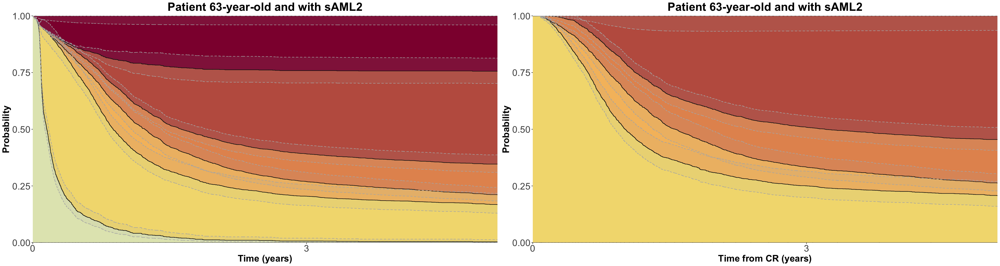

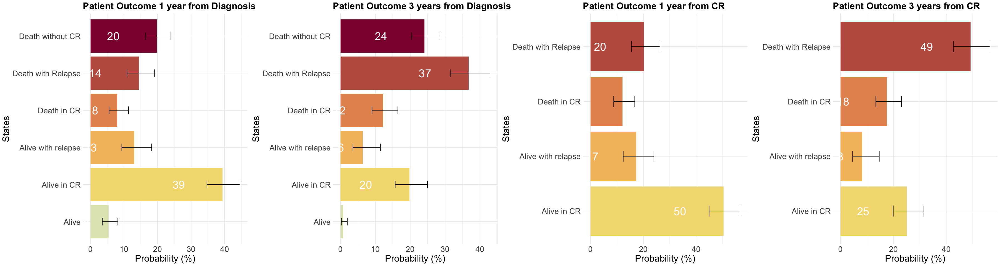

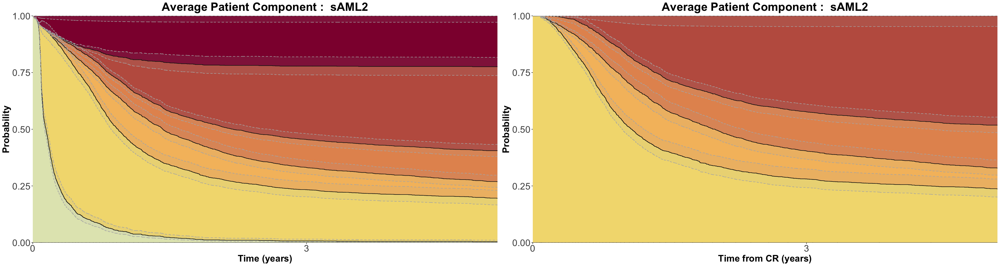

[1] "Intermediate"


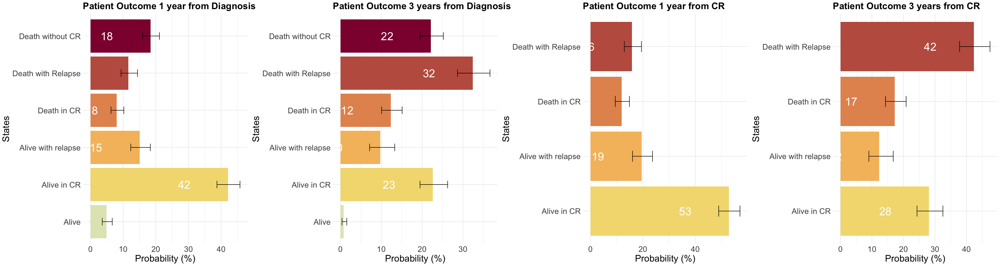

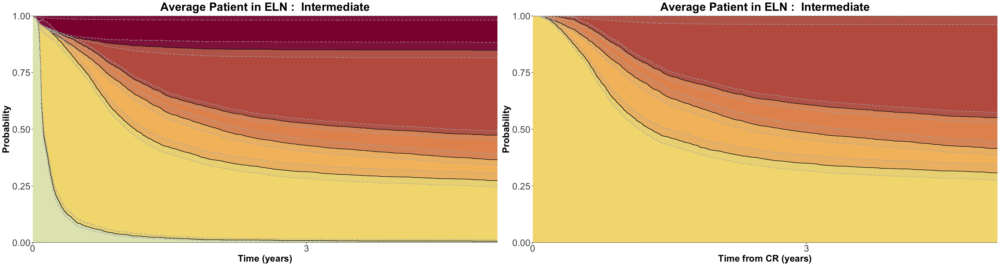

[1] "Adverse"


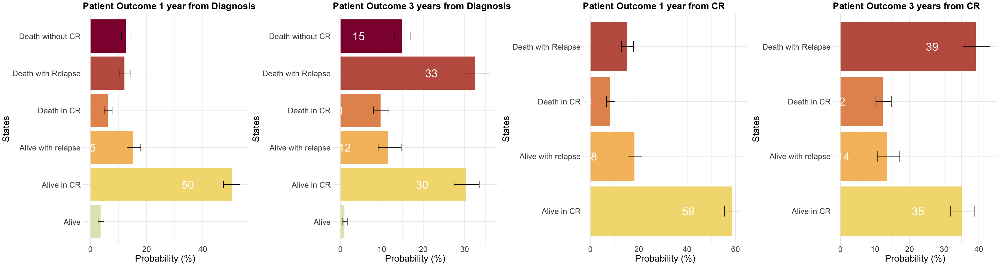

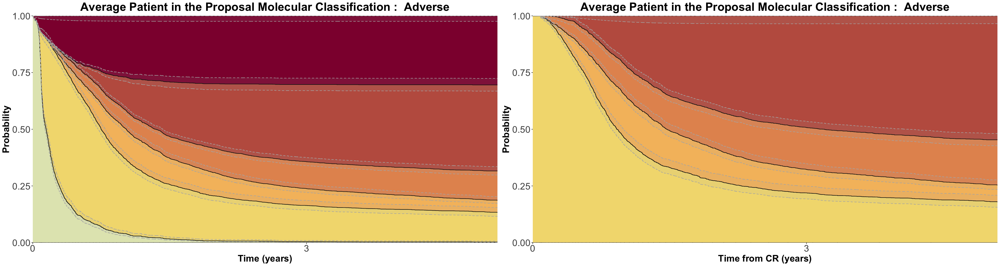

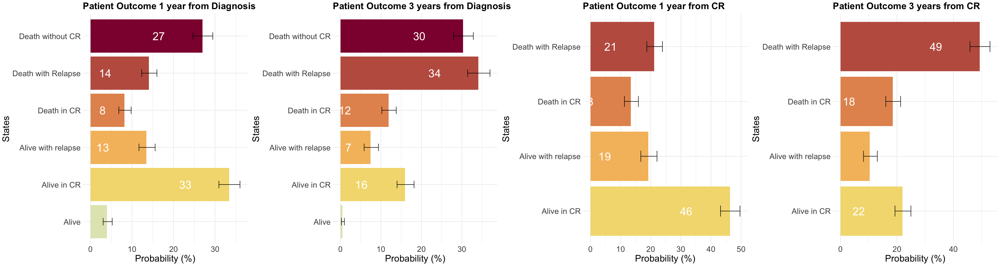

In [24]:
# Find principal component to display and Proposal Risk
user_data_simplified <- classify_components(user_data,proposal=T)
princ_comp_patient <- find_principal_component(user_data_simplified)
# Find ELN risk
eln_patient <- eln_classification_webapp_simplified(data.frame(t(user_data)))$eln_2017
# pdf("Output_patient/Main/Main_examples.pdf",width=30,height=7)


######################################################## PART 1 : needs computation (patient centric) ########################################################

user_data_simplified <- classify_components(user_data,proposal=T)
covariates <- c(demo,clin,comp,"ITD","NEW_favorable","NEW_intermediate","NEW_adverse")
characteristics <- rownames(user_data_simplified[c(comp,"ITD","age"),,F][which(user_data_simplified[c(comp,"ITD","age"),"value"]>0),,F])
set_notebook_plot_size(30,8)
par(mfrow=c(1,2))


tmp_data <- rbind(msdata,rep( NA, ncol( msdata ) ))
tmp_data[nrow(tmp_data),covariates] <- as.numeric(user_data_simplified[covariates,])
patA <- tmp_data[rep(nrow(tmp_data),each=5),covariates]
patA$trans <- 1:5
attr(patA, "trans") <- tmat_data

patA <- expand.covs(patA, covariates, longnames = FALSE)
patA$strata <- patA$trans
msfA <- msfit(cfull, patA, trans = tmat_data)

ptA <- probtrans(msfA, predt = 0,variance=T)
ord <- c(1,2,3,4,5,6)

title_str1<- ifelse("age" %in% characteristics,paste("Patient ","-year-old and with",sep=as.character(round(user_data_simplified["age","value"]))),"Patient with")
title_str2 <- toString(str_remove(characteristics[characteristics %in% c(comp,"ITD")],"full_component_"))
title_str <- paste(title_str1 , title_str2)

probtrans_plot_list  <- list()
for (i in 1:2){
    if(i==1){
        colors <- statecols[1:6]
    } else{
        colors <- statecols[2:5]
    }
    probtrans_plot_list[[i]] <- plot_probtrans_Conf_Interval(ptA,colors = colors, from=i, ord = ord,xlim=c(0,5.1),
                                 main = title_str,
                                xlab=ifelse(i==1,"Time (years)","Time from CR (years)"))
}
grid.arrange(probtrans_plot_list[[1]],probtrans_plot_list[[2]],nrow=1)

ptrans1 <- data.frame(States=c("Alive","Alive in CR","Alive with relapse","Death in CR","Death with Relapse","Death without CR"),
      proba=unlist(ptA[[1]][ptA[[1]]$time>=1 ,c("pstate1","pstate2","pstate3","pstate4","pstate5","pstate6")][1,]*100,use.names = F),
      se=unlist(ptA[[1]][ptA[[1]]$time>=1 ,c("se1","se2","se3","se4","se5","se6")][1,]*100,use.names = F)            )
diagnosis_1 <- ggplot(ptrans1,aes(x=States,y=proba)) + geom_bar(stat="identity", fill=statecols)+
geom_errorbar(aes(ymin=exp(log(proba) - crit * se / proba), ymax=exp(log(proba) + crit * se / proba)),
                  width=.2,                    # Width of the error bars
                  position=position_dodge(.9))+
  geom_text(aes(label=round(proba,0)), vjust=0.5,hjust=4, color="white", size=8.5,face="bold")+ coord_flip()+ylab("Probability (%)")+
  theme_minimal() + theme(axis.text=element_text(size=17),axis.title=element_text(size=20),plot.title=element_text(size=20,face="bold")) +
ggtitle ("Patient Outcome 1 year from Diagnosis")

ptrans3 <- data.frame(States=c("Alive","Alive in CR","Alive with relapse","Death in CR","Death with Relapse","Death without CR"),
              proba=unlist(ptA[[1]][ptA[[1]]$time>=3 ,c("pstate1","pstate2","pstate3","pstate4","pstate5","pstate6")][1,]*100,use.names = F),
              se=unlist(ptA[[1]][ptA[[1]]$time>=3 ,c("se1","se2","se3","se4","se5","se6")][1,]*100,use.names = F)            )
diagnosis_3 <- ggplot(ptrans3,aes(x=States,y=proba)) + geom_bar(stat="identity", fill=statecols)+
geom_errorbar(aes(ymin=exp(log(proba) - crit * se / proba), ymax=exp(log(proba) + crit * se / proba)),
                  width=.2,                    # Width of the error bars
                  position=position_dodge(.9))+
  geom_text(aes(label=round(proba,0)), vjust=0.5,hjust=4, color="white", size=8.5,face="bold")+ coord_flip()+ylab("Probability (%)")+
  theme_minimal() + theme(axis.text=element_text(size=17),axis.title=element_text(size=20),plot.title=element_text(size=20,face="bold")) +
ggtitle ("Patient Outcome 3 years from Diagnosis")

ptrans1_CR <- data.frame(States=c("Alive in CR","Alive with relapse","Death in CR","Death with Relapse"),
              proba=unlist(ptA[[2]][ptA[[2]]$time>=1 ,c("pstate2","pstate3","pstate4","pstate5")][1,]*100,use.names = F),
              se=unlist(ptA[[2]][ptA[[2]]$time>=1 ,c("se2","se3","se4","se5")][1,]*100,use.names = F)            )
CR_1 <- ggplot(ptrans1_CR,aes(x=States,y=proba)) + geom_bar(stat="identity", fill=statecols[2:5])+
geom_errorbar(aes(ymin=exp(log(proba) - crit * se / proba), ymax=exp(log(proba) + crit * se / proba)),
                  width=.2,                    # Width of the error bars
                  position=position_dodge(.9))+
  geom_text(aes(label=round(proba,0)), vjust=0.5,hjust=4, color="white", size=8.5,face="bold")+ coord_flip()+ylab("Probability (%)")+
  theme_minimal() + theme(axis.text=element_text(size=17),axis.title=element_text(size=20),plot.title=element_text(size=20,face="bold")) +
ggtitle ("Patient Outcome 1 year from CR")

ptrans3_CR <- data.frame(States=c("Alive in CR","Alive with relapse","Death in CR","Death with Relapse"),
              proba=unlist(ptA[[2]][ptA[[2]]$time>=3 ,c("pstate2","pstate3","pstate4","pstate5")][1,]*100,use.names = F),
              se=unlist(ptA[[2]][ptA[[2]]$time>=3 ,c("se2","se3","se4","se5")][1,]*100,use.names = F)            )
CR_3 <- ggplot(ptrans3_CR,aes(x=States,y=proba)) + geom_bar(stat="identity", fill=statecols[2:5])+
geom_errorbar(aes(ymin=exp(log(proba) - crit * se / proba), ymax=exp(log(proba) + crit * se / proba)),
                  width=.2,                    # Width of the error bars
                  position=position_dodge(.9))+
  geom_text(aes(label=round(proba,0)), vjust=0.5,hjust=4, color="white", size=8.5,face="bold")+ coord_flip()+ylab("Probability (%)")+
  theme_minimal() + theme(axis.text=element_text(size=17),axis.title=element_text(size=20),plot.title=element_text(size=20,face="bold")) +
ggtitle ("Patient Outcome 3 years from CR")


grid.arrange(diagnosis_1,diagnosis_3,CR_1,CR_3,nrow=1)


######################################################## PART 2 : Principal Component (with or without ITD (precomputed)) ########################################################

# Average Patient in Princ Comp / Princ Comp with ITD : we have already presaved the computations in the cell before and we just need to plot them


### where the patient belongs ?


patient_princ_comp_prob_trans <- eval(parse(text = paste("ptA",princ_comp_patient,sep="_")))
patient_comp_class <- str_replace(str_remove(princ_comp_patient,"full_component_"),"_ITD"," with ITD")

### now we know which probtrans we need and we display the figures (it is instantaneous because no computation here)

probtrans_plot_list  <- list()
for (i in 1:2){
    if(i==1){
        colors <- statecols[1:6]
    } else{
        colors <- statecols[2:5]
    }
    probtrans_plot_list[[i]] <- plot_probtrans_Conf_Interval(patient_princ_comp_prob_trans,colors = colors, from=i, ord = ord,xlim=c(0,5.1),
                                 main = paste("Average Patient Component : ",patient_comp_class),
                                xlab=ifelse(i==1,"Time (years)","Time from CR (years)"))
}
grid.arrange(probtrans_plot_list[[1]],probtrans_plot_list[[2]],nrow=1)

ptrans1_princ_comp <- data.frame(States=c("Alive","Alive in CR","Alive with relapse","Death in CR","Death with Relapse","Death without CR"),
      proba=unlist(patient_princ_comp_prob_trans[[1]][patient_princ_comp_prob_trans[[1]]$time>=1 ,c("pstate1","pstate2","pstate3","pstate4","pstate5","pstate6")][1,]*100,use.names = F),
      se=unlist(patient_princ_comp_prob_trans[[1]][patient_princ_comp_prob_trans[[1]]$time>=1 ,c("se1","se2","se3","se4","se5","se6")][1,]*100,use.names = F)            )
diagnosis_1_princ_comp <- ggplot(ptrans1_princ_comp,aes(x=States,y=proba)) + geom_bar(stat="identity", fill=statecols)+
geom_errorbar(aes(ymin=exp(log(proba) - crit * se / proba), ymax=exp(log(proba) + crit * se / proba)),
                  width=.2,                    # Width of the error bars
                  position=position_dodge(.9))+
  geom_text(aes(label=round(proba,0)), vjust=0.5,hjust=4, color="white", size=8.5,face="bold")+ coord_flip()+ylab("Probability (%)")+
  theme_minimal() + theme(axis.text=element_text(size=17),axis.title=element_text(size=20),plot.title=element_text(size=20,face="bold")) +
ggtitle ("Patient Outcome 1 year from Diagnosis")

ptrans3_princ_comp <- data.frame(States=c("Alive","Alive in CR","Alive with relapse","Death in CR","Death with Relapse","Death without CR"),
              proba=unlist(patient_princ_comp_prob_trans[[1]][patient_princ_comp_prob_trans[[1]]$time>=3 ,c("pstate1","pstate2","pstate3","pstate4","pstate5","pstate6")][1,]*100,use.names = F),
              se=unlist(patient_princ_comp_prob_trans[[1]][patient_princ_comp_prob_trans[[1]]$time>=3 ,c("se1","se2","se3","se4","se5","se6")][1,]*100,use.names = F)            )
diagnosis_3_princ_comp <- ggplot(ptrans3_princ_comp,aes(x=States,y=proba)) + geom_bar(stat="identity", fill=statecols)+
geom_errorbar(aes(ymin=exp(log(proba) - crit * se / proba), ymax=exp(log(proba) + crit * se / proba)),
                  width=.2,                    # Width of the error bars
                  position=position_dodge(.9))+
  geom_text(aes(label=round(proba,0)), vjust=0.5,hjust=4, color="white", size=8.5,face="bold")+ coord_flip()+ylab("Probability (%)")+
  theme_minimal() + theme(axis.text=element_text(size=17),axis.title=element_text(size=20),plot.title=element_text(size=20,face="bold")) +
ggtitle ("Patient Outcome 3 years from Diagnosis")

ptrans1_CR_princ_comp <- data.frame(States=c("Alive in CR","Alive with relapse","Death in CR","Death with Relapse"),
              proba=unlist(patient_princ_comp_prob_trans[[2]][patient_princ_comp_prob_trans[[2]]$time>=1 ,c("pstate2","pstate3","pstate4","pstate5")][1,]*100,use.names = F),
              se=unlist(patient_princ_comp_prob_trans[[2]][patient_princ_comp_prob_trans[[2]]$time>=1 ,c("se2","se3","se4","se5")][1,]*100,use.names = F)            )
CR_1_princ_comp <- ggplot(ptrans1_CR_princ_comp,aes(x=States,y=proba)) + geom_bar(stat="identity", fill=statecols[2:5])+
geom_errorbar(aes(ymin=exp(log(proba) - crit * se / proba), ymax=exp(log(proba) + crit * se / proba)),
                  width=.2,                    # Width of the error bars
                  position=position_dodge(.9))+
  geom_text(aes(label=round(proba,0)), vjust=0.5,hjust=4, color="white", size=8.5,face="bold")+ coord_flip()+ylab("Probability (%)")+
  theme_minimal() + theme(axis.text=element_text(size=17),axis.title=element_text(size=20),plot.title=element_text(size=20,face="bold")) +
ggtitle ("Patient Outcome 1 year from CR")

ptrans3_CR_princ_comp <- data.frame(States=c("Alive in CR","Alive with relapse","Death in CR","Death with Relapse"),
              proba=unlist(patient_princ_comp_prob_trans[[2]][patient_princ_comp_prob_trans[[2]]$time>=3 ,c("pstate2","pstate3","pstate4","pstate5")][1,]*100,use.names = F),
              se=unlist(patient_princ_comp_prob_trans[[2]][patient_princ_comp_prob_trans[[2]]$time>=3 ,c("se2","se3","se4","se5")][1,]*100,use.names = F)            )
CR_3_princ_comp <- ggplot(ptrans3_CR_princ_comp,aes(x=States,y=proba)) + geom_bar(stat="identity", fill=statecols[2:5])+
geom_errorbar(aes(ymin=exp(log(proba) - crit * se / proba), ymax=exp(log(proba) + crit * se / proba)),
                  width=.2,                    # Width of the error bars
                  position=position_dodge(.9))+
  geom_text(aes(label=round(proba,0)), vjust=0.5,hjust=4, color="white", size=8.5,face="bold")+ coord_flip()+ylab("Probability (%)")+
  theme_minimal() + theme(axis.text=element_text(size=17),axis.title=element_text(size=20),plot.title=element_text(size=20,face="bold")) +
ggtitle ("Patient Outcome 3 years from CR")


grid.arrange(diagnosis_1_princ_comp,diagnosis_3_princ_comp,CR_1_princ_comp,CR_3_princ_comp,nrow=1)


######################################################## PART 3 : ELN (precomputed) ########################################################
if(eln_patient=="favorable"){
    patient_eln_prob_trans <- ptA_eln_favorable
    patient_eln_class <- "Favorable" 
} else if (eln_patient=="intermediate"){
    patient_eln_prob_trans <- ptA_eln_intermediate
    patient_eln_class <- "Intermediate" 
} else{
    patient_eln_prob_trans <- ptA_eln_adverse
    patient_eln_class <- "Adverse" 
}
print(patient_eln_class)

### now we know which probtrans we need and we display the figures (it is instantaneous because no computation here)


probtrans_plot_list  <- list()
for (i in 1:2){
    if(i==1){
        colors <- statecols[1:6]
    } else{
        colors <- statecols[2:5]
    }
    probtrans_plot_list[[i]] <- plot_probtrans_Conf_Interval(patient_eln_prob_trans,colors = colors, from=i, ord = ord,xlim=c(0,5.1),
                                 main = paste("Average Patient in ELN : ",patient_eln_class),
                                xlab=ifelse(i==1,"Time (years)","Time from CR (years)"))
}
grid.arrange(probtrans_plot_list[[1]],probtrans_plot_list[[2]],nrow=1)

ptrans1_eln <- data.frame(States=c("Alive","Alive in CR","Alive with relapse","Death in CR","Death with Relapse","Death without CR"),
      proba=unlist(patient_eln_prob_trans[[1]][patient_eln_prob_trans[[1]]$time>=1 ,c("pstate1","pstate2","pstate3","pstate4","pstate5","pstate6")][1,]*100,use.names = F),
      se=unlist(patient_eln_prob_trans[[1]][patient_eln_prob_trans[[1]]$time>=1 ,c("se1","se2","se3","se4","se5","se6")][1,]*100,use.names = F)            )
diagnosis_1_eln <- ggplot(ptrans1_eln,aes(x=States,y=proba)) + geom_bar(stat="identity", fill=statecols)+
geom_errorbar(aes(ymin=exp(log(proba) - crit * se / proba), ymax=exp(log(proba) + crit * se / proba)),
                  width=.2,                    # Width of the error bars
                  position=position_dodge(.9))+
  geom_text(aes(label=round(proba,0)), vjust=0.5,hjust=4, color="white", size=8.5,face="bold")+ coord_flip()+ylab("Probability (%)")+
  theme_minimal() + theme(axis.text=element_text(size=17),axis.title=element_text(size=20),plot.title=element_text(size=20,face="bold")) +
ggtitle ("Patient Outcome 1 year from Diagnosis")

ptrans3_eln <- data.frame(States=c("Alive","Alive in CR","Alive with relapse","Death in CR","Death with Relapse","Death without CR"),
              proba=unlist(patient_eln_prob_trans[[1]][patient_eln_prob_trans[[1]]$time>=3 ,c("pstate1","pstate2","pstate3","pstate4","pstate5","pstate6")][1,]*100,use.names = F),
              se=unlist(patient_eln_prob_trans[[1]][patient_eln_prob_trans[[1]]$time>=3 ,c("se1","se2","se3","se4","se5","se6")][1,]*100,use.names = F)            )
diagnosis_3_eln <- ggplot(ptrans3_eln,aes(x=States,y=proba)) + geom_bar(stat="identity", fill=statecols)+
geom_errorbar(aes(ymin=exp(log(proba) - crit * se / proba), ymax=exp(log(proba) + crit * se / proba)),
                  width=.2,                    # Width of the error bars
                  position=position_dodge(.9))+
  geom_text(aes(label=round(proba,0)), vjust=0.5,hjust=4, color="white", size=8.5,face="bold")+ coord_flip()+ylab("Probability (%)")+
  theme_minimal() + theme(axis.text=element_text(size=17),axis.title=element_text(size=20),plot.title=element_text(size=20,face="bold")) +
ggtitle ("Patient Outcome 3 years from Diagnosis")

ptrans1_CR_eln <- data.frame(States=c("Alive in CR","Alive with relapse","Death in CR","Death with Relapse"),
              proba=unlist(patient_eln_prob_trans[[2]][patient_eln_prob_trans[[2]]$time>=1 ,c("pstate2","pstate3","pstate4","pstate5")][1,]*100,use.names = F),
              se=unlist(patient_eln_prob_trans[[2]][patient_eln_prob_trans[[2]]$time>=1 ,c("se2","se3","se4","se5")][1,]*100,use.names = F)            )
CR_1_eln <- ggplot(ptrans1_CR_eln,aes(x=States,y=proba)) + geom_bar(stat="identity", fill=statecols[2:5])+
geom_errorbar(aes(ymin=exp(log(proba) - crit * se / proba), ymax=exp(log(proba) + crit * se / proba)),
                  width=.2,                    # Width of the error bars
                  position=position_dodge(.9))+
  geom_text(aes(label=round(proba,0)), vjust=0.5,hjust=4, color="white", size=8.5,face="bold")+ coord_flip()+ylab("Probability (%)")+
  theme_minimal() + theme(axis.text=element_text(size=17),axis.title=element_text(size=20),plot.title=element_text(size=20,face="bold")) +
ggtitle ("Patient Outcome 1 year from CR")

ptrans3_CR_eln <- data.frame(States=c("Alive in CR","Alive with relapse","Death in CR","Death with Relapse"),
              proba=unlist(patient_eln_prob_trans[[2]][patient_eln_prob_trans[[2]]$time>=3 ,c("pstate2","pstate3","pstate4","pstate5")][1,]*100,use.names = F),
              se=unlist(patient_eln_prob_trans[[2]][patient_eln_prob_trans[[2]]$time>=3 ,c("se2","se3","se4","se5")][1,]*100,use.names = F)            )
CR_3_eln <- ggplot(ptrans3_CR_eln,aes(x=States,y=proba)) + geom_bar(stat="identity", fill=statecols[2:5])+
geom_errorbar(aes(ymin=exp(log(proba) - crit * se / proba), ymax=exp(log(proba) + crit * se / proba)),
                  width=.2,                    # Width of the error bars
                  position=position_dodge(.9))+
  geom_text(aes(label=round(proba,0)), vjust=0.5,hjust=4, color="white", size=8.5,face="bold")+ coord_flip()+ylab("Probability (%)")+
  theme_minimal() + theme(axis.text=element_text(size=17),axis.title=element_text(size=20),plot.title=element_text(size=20,face="bold")) +
ggtitle ("Patient Outcome 3 years from CR")


grid.arrange(diagnosis_1_eln,diagnosis_3_eln,CR_1_eln,CR_3_eln,nrow=1)



######################################################## PART 4 ########################################################
# Average Patient in risk Proposal : we have already presaved the computations in the cell before and we just need to plot them


### where the patient belongs ?

if(user_data_simplified["NEW_favorable",]==1){
    patient_proposal_prob_trans <- ptA_proposal_favorable
    patient_risk_class <- "Favorable" 
} else if (user_data_simplified["NEW_intermediate",]==1){
    patient_proposal_prob_trans <- ptA_proposal_intermediate
    patient_risk_class <- "Intermediate" 
} else{
    patient_proposal_prob_trans <- ptA_proposal_adverse
    patient_risk_class <- "Adverse" 
}
print(patient_risk_class)

### now we know which probtrans we need and we display the figures (it is instantaneous because no computation here)


probtrans_plot_list  <- list()
for (i in 1:2){
    if(i==1){
        colors <- statecols[1:6]
    } else{
        colors <- statecols[2:5]
    }
    probtrans_plot_list[[i]] <- plot_probtrans_Conf_Interval(patient_proposal_prob_trans,colors = colors, from=i, ord = ord,xlim=c(0,5.1),
                                 main = paste("Average Patient in the Proposal Molecular Classification : ",patient_risk_class),
                                xlab=ifelse(i==1,"Time (years)","Time from CR (years)"))
}
grid.arrange(probtrans_plot_list[[1]],probtrans_plot_list[[2]],nrow=1)

ptrans1_proposal <- data.frame(States=c("Alive","Alive in CR","Alive with relapse","Death in CR","Death with Relapse","Death without CR"),
      proba=unlist(patient_proposal_prob_trans[[1]][patient_proposal_prob_trans[[1]]$time>=1 ,c("pstate1","pstate2","pstate3","pstate4","pstate5","pstate6")][1,]*100,use.names = F),
      se=unlist(patient_proposal_prob_trans[[1]][patient_proposal_prob_trans[[1]]$time>=1 ,c("se1","se2","se3","se4","se5","se6")][1,]*100,use.names = F)            )
diagnosis_1_proposal <- ggplot(ptrans1_proposal,aes(x=States,y=proba)) + geom_bar(stat="identity", fill=statecols)+
geom_errorbar(aes(ymin=exp(log(proba) - crit * se / proba), ymax=exp(log(proba) + crit * se / proba)),
                  width=.2,                    # Width of the error bars
                  position=position_dodge(.9))+
  geom_text(aes(label=round(proba,0)), vjust=0.5,hjust=4, color="white", size=8.5,face="bold")+ coord_flip()+ylab("Probability (%)")+
  theme_minimal() + theme(axis.text=element_text(size=17),axis.title=element_text(size=20),plot.title=element_text(size=20,face="bold")) +
ggtitle ("Patient Outcome 1 year from Diagnosis")

ptrans3_proposal <- data.frame(States=c("Alive","Alive in CR","Alive with relapse","Death in CR","Death with Relapse","Death without CR"),
              proba=unlist(patient_proposal_prob_trans[[1]][patient_proposal_prob_trans[[1]]$time>=3 ,c("pstate1","pstate2","pstate3","pstate4","pstate5","pstate6")][1,]*100,use.names = F),
              se=unlist(patient_proposal_prob_trans[[1]][patient_proposal_prob_trans[[1]]$time>=3 ,c("se1","se2","se3","se4","se5","se6")][1,]*100,use.names = F)            )
diagnosis_3_proposal <- ggplot(ptrans3_proposal,aes(x=States,y=proba)) + geom_bar(stat="identity", fill=statecols)+
geom_errorbar(aes(ymin=exp(log(proba) - crit * se / proba), ymax=exp(log(proba) + crit * se / proba)),
                  width=.2,                    # Width of the error bars
                  position=position_dodge(.9))+
  geom_text(aes(label=round(proba,0)), vjust=0.5,hjust=4, color="white", size=8.5,face="bold")+ coord_flip()+ylab("Probability (%)")+
  theme_minimal() + theme(axis.text=element_text(size=17),axis.title=element_text(size=20),plot.title=element_text(size=20,face="bold")) +
ggtitle ("Patient Outcome 3 years from Diagnosis")

ptrans1_CR_proposal <- data.frame(States=c("Alive in CR","Alive with relapse","Death in CR","Death with Relapse"),
              proba=unlist(patient_proposal_prob_trans[[2]][patient_proposal_prob_trans[[2]]$time>=1 ,c("pstate2","pstate3","pstate4","pstate5")][1,]*100,use.names = F),
              se=unlist(patient_proposal_prob_trans[[2]][patient_proposal_prob_trans[[2]]$time>=1 ,c("se2","se3","se4","se5")][1,]*100,use.names = F)            )
CR_1_proposal <- ggplot(ptrans1_CR_proposal,aes(x=States,y=proba)) + geom_bar(stat="identity", fill=statecols[2:5])+
geom_errorbar(aes(ymin=exp(log(proba) - crit * se / proba), ymax=exp(log(proba) + crit * se / proba)),
                  width=.2,                    # Width of the error bars
                  position=position_dodge(.9))+
  geom_text(aes(label=round(proba,0)), vjust=0.5,hjust=4, color="white", size=8.5,face="bold")+ coord_flip()+ylab("Probability (%)")+
  theme_minimal() + theme(axis.text=element_text(size=17),axis.title=element_text(size=20),plot.title=element_text(size=20,face="bold")) +
ggtitle ("Patient Outcome 1 year from CR")

ptrans3_CR_proposal <- data.frame(States=c("Alive in CR","Alive with relapse","Death in CR","Death with Relapse"),
              proba=unlist(patient_proposal_prob_trans[[2]][patient_proposal_prob_trans[[2]]$time>=3 ,c("pstate2","pstate3","pstate4","pstate5")][1,]*100,use.names = F),
              se=unlist(patient_proposal_prob_trans[[2]][patient_proposal_prob_trans[[2]]$time>=3 ,c("se2","se3","se4","se5")][1,]*100,use.names = F)            )
CR_3_proposal <- ggplot(ptrans3_CR_proposal,aes(x=States,y=proba)) + geom_bar(stat="identity", fill=statecols[2:5])+
geom_errorbar(aes(ymin=exp(log(proba) - crit * se / proba), ymax=exp(log(proba) + crit * se / proba)),
                  width=.2,                    # Width of the error bars
                  position=position_dodge(.9))+
  geom_text(aes(label=round(proba,0)), vjust=0.5,hjust=4, color="white", size=8.5,face="bold")+ coord_flip()+ylab("Probability (%)")+
  theme_minimal() + theme(axis.text=element_text(size=17),axis.title=element_text(size=20),plot.title=element_text(size=20,face="bold")) +
ggtitle ("Patient Outcome 3 years from CR")


grid.arrange(diagnosis_1_proposal,diagnosis_3_proposal,CR_1_proposal,CR_3_proposal,nrow=1)

# dev.off()

## **6. Patient Centric covariate effects.**

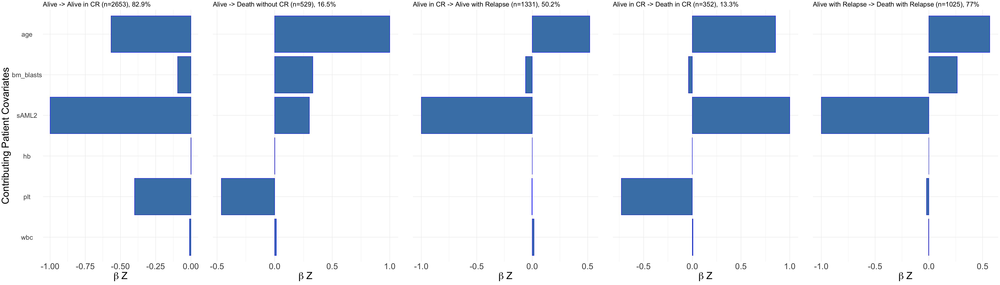

In [25]:
# pdf("Output_patient/Main/Page2_example_with_median_patient.pdf",width=40,height=10)
coef_data <- data.frame(summary(cfull)$coefficients)
set_notebook_plot_size(42,12)
p <- list()
count <- 1
for (trans in c(".1",".2",".3",".4",".5")){
    l <- coef_data[endsWith(rownames(coef_data),trans),]
    rownames(l) <- gsub('.{0,2}$', '', rownames(l))

    k <- merge(l,user_data_simplified,by=0)
    k$average_patient <- 0
    k$average_patient <- ifelse(k$Row.names %in% names(covariates_median),covariates_median[k$Row.names],0)
    k["BetaZs"] <- k$coef * (k$value-k$average_patient)
    k["BetaZs"] <- k["BetaZs"] / max(abs(k["BetaZs"]))
    k <- k[(k$BetaZs!=0 & !is.na(k$BetaZs)),]
    #k["BetaZ"] <- k$coef * (k$value)
    #k["BetaZ"] <- k["BetaZ"] / max(abs(k["BetaZ"]))
    k <- k[(k$BetaZs!=0 & !is.na(k$BetaZs)),]
    
    
    k$Row.names <- str_remove(k$Row.names,"full_component_")
#     k <- k[order(k["BetaZ"],decreasing=T),]
    
    title <- ifelse(trans==".1","Alive -> Alive in CR (n=2653), 82.9%",
                   ifelse(trans==".2","Alive -> Death without CR (n=529), 16.5%",
                         ifelse(trans==".3","Alive in CR -> Alive with Relapse (n=1331), 50.2%",
                               ifelse(trans==".4","Alive in CR -> Death in CR (n=352), 13.3%","Alive with Relapse -> Death with Relapse (n=1025), 77%"))))
    xlab <- ifelse(trans==".1","Contributing Patient Covariates","")
    p[[trans]] <- ggplot(data = k,aes(x = factor(Row.names,level=rev(Row.names)),y= BetaZs)) + geom_bar(stat="identity",colour="blue",fill="steelblue") + coord_flip() + xlab(xlab) + ylab(expression(beta ~ Z)) + ggtitle(title) +
    theme_minimal() + theme(axis.title=element_text(size=30),axis.text.y=element_blank(),plot.title=element_text(size=20),axis.text.x=element_text(size=25)) 
    
    if(trans==".1"){
        p[[trans]] <- p[[trans]] + theme(axis.text.y=element_text(size=20))
    }
    #+ ifelse(trans==".1",theme(axis.text.x=element_text(size=20)),theme(axis.text.y=element_blank(),axis.ticks.y=element_blank()))
    #ifelse(trans==".1",theme(axis.text.x=element_blank()),theme(axis.text.x=element_text(size=20)))
    
}
do.call("grid.arrange",c(p,nrow=1))

# ****

# ****

# ****

# ****

# ****

# ****

# ****